In [1]:
from collections import namedtuple
import torchvision.transforms as T
import torchvision.transforms.functional as F
from PIL import Image, ImageEnhance
import random
import numpy as np
import torch
import torchvision
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from torchvision.datasets import OxfordIIITPet
from torchvision.transforms import functional as TF
from PIL import Image, ImageDraw


In [2]:

#--------------------------------------------------------------------------------
# Definitions
#--------------------------------------------------------------------------------
 
# a label and all meta information
Label = namedtuple( 'Label' , [

    'name'        , # The identifier of this label, e.g. 'car', 'person', ... .
                    # We use them to uniquely name a class

    'id'          , # An integer ID that is associated with this label.
                    # The IDs are used to represent the label in ground truth images
                    # An ID of -1 means that this label does not have an ID and thus
                    # is ignored when creating ground truth images (e.g. license plate).

    'trainId'     , # An integer ID that overwrites the ID above, when creating ground truth
                    # images for training.
                    # For training, multiple labels might have the same ID. Then, these labels
                    # are mapped to the same class in the ground truth images. For the inverse
                    # mapping, we use the label that is defined first in the list below.
                    # For example, mapping all void-type classes to the same ID in training,
                    # might make sense for some approaches.

    'category'    , # The name of the category that this label belongs to

    'categoryId'  , # The ID of this category. Used to create ground truth images
                    # on category level.

    'hasInstances', # Whether this label distinguishes between single instances or not

    'ignoreInEval', # Whether pixels having this class as ground truth label are ignored
                    # during evaluations or not

    'color'       , # The color of this label
    ] )


#--------------------------------------------------------------------------------
# A list of all labels
#--------------------------------------------------------------------------------

# Please adapt the train IDs as appropriate for you approach.
# Note that you might want to ignore labels with ID 255 during training.
# Make sure to provide your results using the original IDs and not the training IDs.
# Note that many IDs are ignored in evaluation and thus you never need to predict these!

labels = [
    #       name                     id    trainId   category            catId     hasInstances   ignoreInEval   color
    Label(  'unlabeled'            ,  0 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'ego vehicle'          ,  1 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'rectification border' ,  2 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'out of roi'           ,  3 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'static'               ,  4 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'dynamic'              ,  5 ,      255 , 'void'            , 0       , False        , True         , (111, 74,  0) ),
    Label(  'ground'               ,  6 ,      255 , 'void'            , 0       , False        , True         , ( 81,  0, 81) ),
    Label(  'road'                 ,  7 ,        0 , 'ground'          , 1       , False        , False        , (128, 64,128) ),
    Label(  'sidewalk'             ,  8 ,        1 , 'ground'          , 1       , False        , False        , (244, 35,232) ),
    Label(  'parking'              ,  9 ,      255 , 'ground'          , 1       , False        , True         , (250,170,160) ),
    Label(  'rail track'           , 10 ,      255 , 'ground'          , 1       , False        , True         , (230,150,140) ),
    Label(  'building'             , 11 ,        2 , 'construction'    , 2       , False        , False        , ( 70, 70, 70) ),
    Label(  'wall'                 , 12 ,        3 , 'construction'    , 2       , False        , False        , (102,102,156) ),
    Label(  'fence'                , 13 ,        4 , 'construction'    , 2       , False        , False        , (190,153,153) ),
    Label(  'guard rail'           , 14 ,      255 , 'construction'    , 2       , False        , True         , (180,165,180) ),
    Label(  'bridge'               , 15 ,      255 , 'construction'    , 2       , False        , True         , (150,100,100) ),
    Label(  'tunnel'               , 16 ,      255 , 'construction'    , 2       , False        , True         , (150,120, 90) ),
    Label(  'pole'                 , 17 ,        5 , 'object'          , 3       , False        , False        , (153,153,153) ),
    Label(  'polegroup'            , 18 ,      255 , 'object'          , 3       , False        , True         , (153,153,153) ),
    Label(  'traffic light'        , 19 ,        6 , 'object'          , 3       , False        , False        , (250,170, 30) ),
    Label(  'traffic sign'         , 20 ,        7 , 'object'          , 3       , False        , False        , (220,220,  0) ),
    Label(  'vegetation'           , 21 ,        8 , 'nature'          , 4       , False        , False        , (107,142, 35) ),
    Label(  'terrain'              , 22 ,        9 , 'nature'          , 4       , False        , False        , (152,251,152) ),
    Label(  'sky'                  , 23 ,       10 , 'sky'             , 5       , False        , False        , ( 70,130,180) ),
    Label(  'person'               , 24 ,       11 , 'human'           , 6       , True         , False        , (220, 20, 60) ),
    Label(  'rider'                , 25 ,       12 , 'human'           , 6       , True         , False        , (255,  0,  0) ),
    Label(  'car'                  , 26 ,       13 , 'vehicle'         , 7       , True         , False        , (  0,  0,142) ),
    Label(  'truck'                , 27 ,       14 , 'vehicle'         , 7       , True         , False        , (  0,  0, 70) ),
    Label(  'bus'                  , 28 ,       15 , 'vehicle'         , 7       , True         , False        , (  0, 60,100) ),
    Label(  'caravan'              , 29 ,      255 , 'vehicle'         , 7       , True         , True         , (  0,  0, 90) ),
    Label(  'trailer'              , 30 ,      255 , 'vehicle'         , 7       , True         , True         , (  0,  0,110) ),
    Label(  'train'                , 31 ,       16 , 'vehicle'         , 7       , True         , False        , (  0, 80,100) ),
    Label(  'motorcycle'           , 32 ,       17 , 'vehicle'         , 7       , True         , False        , (  0,  0,230) ),
    Label(  'bicycle'              , 33 ,       18 , 'vehicle'         , 7       , True         , False        , (119, 11, 32) ),
    Label(  'license plate'        , 34 ,       19 , 'vehicle'         , 7       , False        , True         , (  0,  0,142) ),
]

In [3]:
import os
import cv2

# List the files in the Cityscapes dataset directory
os.listdir('/kaggle/input/cityscapes-segmentation')


['labels', 'images']

In [4]:
import os
import shutil

# Paths
labels_folder = '/kaggle/input/cityscapes-segmentation/labels/train'
new_labels_folder = '/kaggle/working/labels_no_json/train'  


if not os.path.exists(new_labels_folder):
    os.makedirs(new_labels_folder)

for subfolder in os.listdir(labels_folder):
    subfolder_path = os.path.join(labels_folder, subfolder)

    if os.path.isdir(subfolder_path):
        new_subfolder = os.path.join(new_labels_folder, subfolder)
        if not os.path.exists(new_subfolder):
            os.makedirs(new_subfolder)

        for filename in os.listdir(subfolder_path):
            if not filename.endswith('.json'):  # Skip JSON files
                original_file_path = os.path.join(subfolder_path, filename)

                shutil.copy(original_file_path, new_subfolder)

print('All non-JSON files have been copied to the new labels folder.')



All non-JSON files have been copied to the new labels folder.


In [5]:
# Extracting trainId values
train_ids = [label.trainId for label in labels]

# Getting unique trainIds using a set
unique_train_ids = set(train_ids)

# Counting unique trainIds
num_unique_train_ids = len(unique_train_ids)

# Display the result
print(f'Number of unique trainId values: {num_unique_train_ids}')


Number of unique trainId values: 21


In [6]:
print(cv2.imread("/kaggle/input/cityscapes-segmentation/images/train/aachen/aachen_000000_000019_leftImg8bit.png",cv2.IMREAD_UNCHANGED).shape)
print(cv2.imread("/kaggle/input/cityscapes-segmentation/labels/train/aachen/aachen_000000_000019_gtFine_labelTrainIds.png",cv2.IMREAD_UNCHANGED).shape)

(1024, 2048, 3)
(1024, 2048)


In [7]:

image_path = "/kaggle/input/cityscapes-segmentation/labels/train/aachen/aachen_000000_000019_gtFine_labelTrainIds.png"
image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)  

# Check the shape of the image
print(f"Image shape: {image.shape}")

# Get the unique pixel values
unique_values = np.unique(image)
print(f"Unique pixel values: {unique_values}")



Image shape: (1024, 2048)
Unique pixel values: [  0   1   2   5   7   8   9  10  11  12  13  18 255]


In [8]:
class_id_to_color = {label.trainId: label.color for label in labels if label.trainId != 255}

# Ensure background and ignored pixels are black (optional)
class_id_to_color[255] = (0, 0, 0)  # Background or ignored pixels

def one_hot_encode_and_color(class_id_image):
    if len(class_id_image.shape) != 2:  # Check if the input is 2D
        raise ValueError("Input image should be a 2D array of class IDs.")

    h, w = class_id_image.shape  # Get height and width
    colored_image = np.zeros((h, w, 3), dtype=np.uint8)  # Initialize RGB image
    one_hot_encoding_image = np.zeros((h, w, 21), dtype=np.uint8)

    # Map each class ID to its respective color
    for class_id, color in class_id_to_color.items():
        mask = class_id_image == class_id  # Create a mask for the current class ID
        colored_image[mask] = color  # Apply the color to the corresponding pixels
        
    for class_id in range(21):
        one_hot_encoding_image[:, :, class_id] = (class_id_image == class_id).astype(np.uint8)

    return colored_image, one_hot_encoding_image

In [9]:
import os
from PIL import Image
import numpy as np
import torch
from torch.utils.data import Dataset
from torchvision import transforms  # Import transforms

class CityscapesDataset(Dataset):
    def __init__(self, images_folder, labels_folder, transform=None):
        self.images_folder = images_folder
        self.labels_folder = labels_folder
        self.transform = transform
        
        # Create lists of image and label paths
        self.image_paths = []
        self.label_paths = []
        self.color_jitter = transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1)
#         self.random_horizontal_flip = transforms.RandomHorizontalFlip(p=0.5)  # Add horizontal flip transformation

        # Populate the paths
        for city in os.listdir(images_folder):
            city_path = os.path.join(images_folder, city)
            if os.path.isdir(city_path):
                for image_file in os.listdir(city_path):
                    if image_file.endswith('_leftImg8bit.png'):  # Assuming this is the format for train images
                        # Add image path
                        image_path = os.path.join(city_path, image_file)
                        self.image_paths.append(image_path)

                        # Construct the corresponding label path
                        # Assuming labels are named as 'cityname_XXXXXX_gtFine_labelTrainIds.png'
                        label_file = image_file.replace('_leftImg8bit.png', '_gtFine_labelTrainIds.png')
                        label_path = os.path.join(labels_folder, city, label_file)
                        self.label_paths.append(label_path)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        # Load the image using the idx
        image_path = self.image_paths[idx]
        label_path = self.label_paths[idx]

        image = Image.open(image_path).convert('RGB')
        label = Image.open(label_path).convert('L')  # Load as grayscale for class IDs
        
        image = image.resize((1024, 512), Image.BILINEAR)  # Resize to (width, height)
        label = label.resize((1024, 512), Image.NEAREST)   # Use NEAREST for labels to avoid interpolation
       
        image = self.color_jitter(image)

        # Apply Random Horizontal Flip to both image and label
#         if self.random_horizontal_flip is not None:
#             image = self.random_horizontal_flip(image)
#             label = self.random_horizontal_flip(label)  # it got worse so i removed it

        # Convert to numpy arrays
        image_array = np.array(image)
        label_array = np.array(label)

        # Apply the one-hot encoding and coloring function
        colored_image, one_hot_encoding_image = one_hot_encode_and_color(label_array)

        # Apply transformations if any (you may want to do this before converting to tensors)
        if self.transform:
            image_array = self.transform(image_array)

        # Convert to PyTorch tensors and reorder dimensions
        image_tensor = torch.from_numpy(image_array).permute(2, 0, 1)  # Shape: (3, height, width)
        image_tensor = image_tensor.float() / 255.0 

        # Convert one-hot encoded labels to tensor and reorder dimensions
        one_hot_encoding_tensor = torch.from_numpy(one_hot_encoding_image).permute(2, 0, 1)  # Shape: (21, height, width)

        return image_tensor, one_hot_encoding_tensor  # Return images and labels in compatible shapes


In [10]:
from torch.utils.data import DataLoader, Subset, random_split
seed_value = 42
torch.manual_seed(seed_value)
np.random.seed(seed_value)
images_folder = '/kaggle/input/cityscapes-segmentation/images/train'
labels_folder = '/kaggle/working/labels_no_json/train'

# Instantiate the dataset

cityscapes_dataset = CityscapesDataset(images_folder, labels_folder)

# Split dataset into training (90%) and validation (10%)
train_size = int(0.9 * len(cityscapes_dataset))
val_size = len(cityscapes_dataset) - train_size
train_dataset, val_dataset = random_split(cityscapes_dataset, [train_size, val_size])

# Create DataLoaders
train_indices = torch.randperm(len(train_dataset))[:20]  # Randomly select 100 indices
val_indices = torch.randperm(len(val_dataset))[:5]      # Randomly select 20 indices

# Create subsets of the datasets
train_subset = Subset(train_dataset, train_indices)
val_subset = Subset(val_dataset, val_indices)

train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True,num_workers=4)  # Adjust batch size as needed
val_dataloader = DataLoader(val_dataset, batch_size=8, shuffle=False,num_workers=4)  # Shuffle is typically False for validation

# Get the first batch from the training DataLoader
first_batch = next(iter(train_dataloader))

# Unpack the batch
batch_images, batch_labels = first_batch

# Print the shapes of the first batch
print(f'Training Batch images shape: {batch_images.shape}')  # (batch_size, 3, height, width)
print(f'Training Batch labels shape: {batch_labels.shape}')  # (batch_size, 21, height, width)

Training Batch images shape: torch.Size([8, 3, 512, 1024])
Training Batch labels shape: torch.Size([8, 21, 512, 1024])


# PSPNET model

In [11]:
import torch
from torch import nn
from torch.nn import functional as F
from torchvision.models import resnet34

class PSPModule(nn.Module):
    def __init__(self, features, out_features=1024, sizes=(1, 2, 3, 6)):
        super().__init__()
        self.stages = nn.ModuleList([self._make_stage(features, size) for size in sizes])
        self.bottleneck = nn.Conv2d(features * (len(sizes) + 1), out_features, kernel_size=1)
        self.relu = nn.ReLU()

    def _make_stage(self, features, size):
        prior = nn.AdaptiveAvgPool2d(output_size=(size, size))
        conv = nn.Conv2d(features, features, kernel_size=1, bias=False)
        return nn.Sequential(prior, conv)

    def forward(self, feats):
        h, w = feats.size(2), feats.size(3)
        priors = [F.interpolate(input=stage(feats), size=(h, w), mode='bilinear') for stage in self.stages] + [feats]
        bottle = self.bottleneck(torch.cat(priors, 1))
        return self.relu(bottle)

class PSPUpsample(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.PReLU()
        )

    def forward(self, x):
        # Double the spatial dimensions
        h, w = 2 * x.size(2), 2 * x.size(3)
        p = F.interpolate(input=x, size=(h, w), mode='bilinear')
        return self.conv(p)

class PSPNet(nn.Module):
    def __init__(self, n_classes=21, sizes=(1, 2, 3, 6), psp_size=512, deep_features_size=512, pretrained=True):
        super().__init__()
        
        # Load the pretrained ResNet-34 model
        resnet = resnet34(pretrained=pretrained)
        
        # Extract layers from ResNet-34
        self.backbone = nn.Sequential(*list(resnet.children())[:-2])  # Remove the fully connected layer and avgpool
        self.psp = PSPModule(psp_size, 1024, sizes)
        self.drop_1 = nn.Dropout2d(p=0.3)

        # Adjust the upsampling layers to ensure final output size
        self.up_1 = PSPUpsample(1024, 256)
        self.up_2 = PSPUpsample(256, 128)
        self.up_3 = PSPUpsample(128, 64)

        self.drop_2 = nn.Dropout2d(p=0.15)
        self.final = nn.Sequential(
            nn.Conv2d(64, n_classes, kernel_size=1),
            nn.LogSoftmax(dim=1)
        )

        self.classifier = nn.Sequential(
            nn.Linear(deep_features_size, 256),
            nn.ReLU(),
            nn.Linear(256, n_classes)
        )

    def forward(self, x):
        # Forward pass through the ResNet backbone
        f = self.backbone(x)
        
        # Process features through PSP Module
        p = self.psp(f)
        p = self.drop_1(p)

        # Upsampling steps
        p = self.up_1(p)
        p = self.drop_2(p)

        p = self.up_2(p)
        p = self.drop_2(p)

        p = self.up_3(p)
        p = self.drop_2(p)

        # Final interpolation to ensure output size matches target
#         p = F.interpolate(input=p, size=(1024, 2048), mode='bilinear')
        p = F.interpolate(input=p, size=(512, 1024), mode='bilinear')

        # Create auxiliary features for classification
        auxiliary = F.adaptive_max_pool2d(input=f, output_size=(1, 1)).view(-1, f.size(1))

        return self.final(p), self.classifier(auxiliary)

In [12]:
import torch
from torch import optim
from torch.utils.data import DataLoader

# Create PSPNet instance
model = PSPNet(n_classes=21, pretrained=True)

# Move the model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 208MB/s] 


# Unet model

In [13]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class UNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=21, init_features=32):
        super(UNet, self).__init__()
        
        features = init_features
        self.encoder1 = UNet._block(in_channels, features, name="enc1")
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder2 = UNet._block(features, features * 2, name="enc2")
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder3 = UNet._block(features * 2, features * 4, name="enc3")
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder4 = UNet._block(features * 4, features * 8, name="enc4")
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)
        
        self.bottleneck = UNet._block(features * 8, features * 16, name="bottleneck")
        
        self.upconv4 = nn.ConvTranspose2d(
            features * 16, features * 8, kernel_size=2, stride=2
        )
        self.decoder4 = UNet._block((features * 8) * 2, features * 8, name="dec4")
        self.upconv3 = nn.ConvTranspose2d(
            features * 8, features * 4, kernel_size=2, stride=2
        )
        self.decoder3 = UNet._block((features * 4) * 2, features * 4, name="dec3")
        self.upconv2 = nn.ConvTranspose2d(
            features * 4, features * 2, kernel_size=2, stride=2
        )
        self.decoder2 = UNet._block((features * 2) * 2, features * 2, name="dec2")
        self.upconv1 = nn.ConvTranspose2d(
            features * 2, features, kernel_size=2, stride=2
        )
        self.decoder1 = UNet._block(features * 2, features, name="dec1")
        
        self.conv = nn.Conv2d(
            in_channels=features, out_channels=out_channels, kernel_size=1
        )

    def forward(self, x):
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(self.pool1(enc1))
        enc3 = self.encoder3(self.pool2(enc2))
        enc4 = self.encoder4(self.pool3(enc3))
        
        bottleneck = self.bottleneck(self.pool4(enc4))
        
        dec4 = self.upconv4(bottleneck)
        dec4 = torch.cat((dec4, enc4), dim=1)
        dec4 = self.decoder4(dec4)
        
        dec3 = self.upconv3(dec4)
        dec3 = torch.cat((dec3, enc3), dim=1)
        dec3 = self.decoder3(dec3)
        
        dec2 = self.upconv2(dec3)
        dec2 = torch.cat((dec2, enc2), dim=1)
        dec2 = self.decoder2(dec2)
        
        dec1 = self.upconv1(dec2)
        dec1 = torch.cat((dec1, enc1), dim=1)
        dec1 = self.decoder1(dec1)
        
        return self.conv(dec1)

    @staticmethod
    def _block(in_channels, features, name):
        return ResidualBlock(in_channels, features)

class ResidualBlock(nn.Module):
    def __init__(self, in_channels, features):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(
            in_channels=in_channels,
            out_channels=features,
            kernel_size=3,
            padding=1,
            bias=False,
        )
        self.bn1 = nn.BatchNorm2d(num_features=features)
        self.activation = nn.SiLU(inplace=True)
        self.conv2 = nn.Conv2d(
            in_channels=features,
            out_channels=features,
            kernel_size=3,
            padding=1,
            bias=False,
        )
        self.bn2 = nn.BatchNorm2d(num_features=features)

        # Residual connection
        if in_channels != features:
            self.residual = nn.Conv2d(in_channels, features, kernel_size=1, bias=False)
        else:
            self.residual = nn.Identity()

    def forward(self, x):
        residual = self.residual(x)
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.activation(out)
        out = self.conv2(out)
        out = self.bn2(out)
        out += residual  # Add residual connection
        out = self.activation(out)
        return out

# Instantiate the model
model = UNet(in_channels=3, out_channels=21)

# Print the model architecture
print(model)

# Test the model with a sample input
sample_input = torch.randn(8, 3, 512, 1024)  # Batch of 8 images
output = model(sample_input)
print("Output shape:", output.shape)  # Expected: torch.Size([8, 21, 512, 1024])

UNet(
  (encoder1): ResidualBlock(
    (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation): SiLU(inplace=True)
    (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (residual): Conv2d(3, 32, kernel_size=(1, 1), stride=(1, 1), bias=False)
  )
  (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (encoder2): ResidualBlock(
    (conv1): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (activation): SiLU(inplace=True)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=

In [14]:
# Loss function
criterion = nn.CrossEntropyLoss()  # For multi-class segmentation

# Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [15]:
def visualize_output(data, target, output, num_images=5):
    """
    Visualize the original images, ground truth, and predicted masks.
    
    Args:
        data: Batch of input images.
        target: Ground truth masks.
        output: Model predictions (segmentation masks).
        num_images: Number of images to display.
    """
    # Move tensors to CPU and convert to numpy
    data = data.cpu().numpy()
    target = target.cpu().numpy()
    output = output.argmax(dim=1).cpu().numpy()  # Get the predicted classes

    # Check the shape of target
    if len(target.shape) == 3:  # (batch_size, height, width)
        target = target.squeeze(0)  # Remove batch dimension if it's 1
    elif len(target.shape) == 4:  # (batch_size, num_classes, height, width)
        target = target.argmax(axis=1)  # Convert to (batch_size, height, width)

    # Determine how many images to visualize based on the actual batch size
    num_images_to_show = min(num_images, data.shape[0])  # Limit to available images

    # Set up the plot
    plt.figure(figsize=(15, 5))
    for i in range(num_images_to_show):
        # Original image
        plt.subplot(3, num_images, i + 1)
        plt.imshow(np.transpose(data[i], (1, 2, 0)))  # Transpose to (H, W, C)
        plt.title("Input Image")
        plt.axis('off')

        # Ground truth mask
        plt.subplot(3, num_images, i + 1 + num_images)
        colored_gt, _ = one_hot_encode_and_color(target[i])  # Colorize the ground truth
        plt.imshow(colored_gt)
        plt.title("Ground Truth")
        plt.axis('off')

        # Predicted mask
        plt.subplot(3, num_images, i + 1 + 2 * num_images)
        colored_pred, _ = one_hot_encode_and_color(output[i])  # Colorize the predicted mask
        plt.imshow(colored_pred)
        plt.title("Predicted Mask")
        plt.axis('off')

    plt.tight_layout()
    plt.show()


In [16]:
import torch
import torch.nn.functional as F

def dice_loss(outputs, targets, n_classes=21, ignore_index=255):
    """Computes the Dice loss for multi-class predictions."""
    dice_losses = []

    # Convert model outputs to predicted probabilities using softmax
    probs = F.softmax(outputs, dim=1)

    for class_id in range(n_classes):
        # Ignore specific classes (e.g., void class 255)
        if class_id == ignore_index:
            continue

        # Create binary masks for the current class
        pred_mask = probs[:, class_id, :, :]
        target_mask = (targets == class_id).float()

        # Calculate intersection and union for the current class
        intersection = (pred_mask * target_mask).sum()
        union = pred_mask.sum() + target_mask.sum()

        # Avoid division by zero
        if union == 0:
            dice_loss_value = 0.0  # No loss if both masks are empty
        else:
            dice_loss_value = 1 - (2.0 * intersection + 1) / (union + 1)  # Smoothing to avoid division by zero

        # Append the loss for the current class
        dice_losses.append(dice_loss_value)

    # Return the mean Dice loss across all valid classes
    return torch.mean(torch.stack(dice_losses)) if dice_losses else torch.tensor(0.0)


In [17]:
# Saving checkpoint after each epoch
def save_checkpoint(epoch, model, optimizer, train_loss, train_accuracy, checkpoint_path='checkpoint.pth'):
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'train_loss': train_loss,
        'train_accuracy': train_accuracy,
    }, checkpoint_path)


# Training loop for PSPNET

In [18]:
# import torch
# import torch.optim as optim
# import torch.nn.functional as F
# from tqdm import tqdm
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# model = model.to(device)

# # Wrap the model in DataParallel to utilize multiple GPUs
# if torch.cuda.device_count() > 1:
#     model = torch.nn.DataParallel(model)

# # Training function
# def train(model, train_dataloader, optimizer, criterion, device):
#     model.train()
#     running_loss = 0.0
#     correct = 0  # Initialize correct predictions counter
#     total = 0  # Initialize total predictions counter
#     running_dice_loss = 0.0  # Track Dice Loss

    
#     for data, target in tqdm(train_dataloader):
#         data, target = data.to(device), target.to(device)

#         # Get the auxiliary target by taking the argmax along the class dimension
#         auxiliary_target = torch.argmax(target, dim=1)  # Shape: (batch_size, height, width)

#         # Prepare auxiliary target
#         auxiliary_target = auxiliary_target.view(auxiliary_target.size(0), -1)  # Shape: (batch_size, height * width)
#         auxiliary_target = torch.mode(auxiliary_target, dim=1).values  # Shape: (batch_size,)

#         # Zero the gradients
#         optimizer.zero_grad()

#         # Forward pass
#         output, aux_output = model(data)

#         # Compute the loss
#         target = torch.argmax(target, dim=1)  # Convert to shape (batch_size, height, width)
#         loss_main = criterion(output, target)
#         loss_aux = criterion(aux_output, auxiliary_target)
#         dice = dice_loss(output, target)

#         loss = loss_main+0.5 *loss_aux+2*dice  # Combine main and auxiliary losses
#         # loss=dice
#         # Backward pass and optimize
#         loss.backward()
#         optimizer.step()

#         # Accumulate loss
#         running_loss += loss.item()
#         running_dice_loss += dice.item()
#         # Calculate accuracy
#         pred = output.argmax(dim=1, keepdim=True)  # Get the predicted classes
#         correct += pred.eq(target.view_as(pred)).sum().item()  # Count correct predictions
#         total += target.numel()  # Count total predictions

#     # Calculate accuracy for the training data
#     accuracy = 100. * correct / total
#     return running_loss / len(train_dataloader), running_dice_loss / len(train_dataloader), accuracy
#     # return running_loss / len(train_dataloader), accuracy  # Return loss and accuracy

# # Validation function (unchanged)
# def validate(model, val_dataloader, criterion, device):
#     model.eval()
#     val_loss = 0.0
#     correct = 0
#     total = 0  # Initialize total predictions counter
#     val_dice_loss=0.0
#     with torch.no_grad():
#         for data, target in val_dataloader:
#             data, target = data.to(device), target.to(device)

#             auxiliary_target = torch.argmax(target, dim=1)  # Shape: (batch_size, height, width)

#             # Prepare auxiliary target
#             auxiliary_target = auxiliary_target.view(auxiliary_target.size(0), -1)  # Shape: (batch_size, height * width)
#             auxiliary_target = torch.mode(auxiliary_target, dim=1).values  # Shape: (batch_size,)

#             # Forward pass
#             output, aux_output = model(data)

#             # Compute loss
#             target = torch.argmax(target, dim=1)  # Convert to shape (batch_size, height, width)
#             loss_main = criterion(output, target)
#             loss_aux = criterion(aux_output, auxiliary_target)
#             dice = dice_loss(output, target)

#             # loss = loss_main + 0.4 * loss_aux+dice
#             loss = loss_main+0.5 *loss_aux+2*dice  # Combine main and auxiliary losses

#             # loss=dice
#             val_loss += loss.item()
#             val_dice_loss += dice.item()

#             # Calculate accuracy
#             pred = output.argmax(dim=1, keepdim=True)  # Get the predicted classes
#             correct += pred.eq(target.view_as(pred)).sum().item()  # Count correct predictions
#             total += target.numel()  # Count total predictions (pixels)

#     val_loss /= len(val_dataloader)
#     accuracy = 100. * correct / total  # Use the total number of pixels for accuracy calculation

#     # return val_loss, accuracy
#     return val_loss / len(val_dataloader), val_dice_loss / len(val_dataloader), accuracy

# # Training loop
# import matplotlib.pyplot as plt
# n_epochs = 40
# for epoch in range(1, n_epochs + 1):
#     print(f"Epoch {epoch}/{n_epochs}:")

#     # Training
#     # train_loss, train_accuracy = train(model, train_dataloader, optimizer, criterion, device)
#     # print(f"Training Loss: {train_loss:.4f}, Training Accuracy: {train_accuracy:.2f}%")
#     train_loss, train_dice_loss, train_accuracy = train(model, train_dataloader, optimizer, criterion, device)
#     print(f"Training Loss: {train_loss:.4f}, Dice Loss: {train_dice_loss:.4f}, Training Accuracy: {train_accuracy:.2f}%")
#     # Validation
#     # val_loss, val_accuracy = validate(model, val_dataloader, criterion, device)
#     # print(f"Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%")
#     val_loss, val_dice_loss, val_accuracy = validate(model, val_dataloader, criterion, device)
#     print(f"Validation Loss: {val_loss:.4f}, Dice Loss: {val_dice_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%")

#     # Visualize the outputs after validation
#     with torch.no_grad():
#         for data, target in val_dataloader:
#             data, target = data.to(device), target.to(device)
#             output, _ = model(data)
#             visualize_output(data, target, output, num_images=5)  # Visualize 5 images
#             break  # Remove this if you want to visualize from multiple batches
# save_checkpoint(epoch, model, optimizer, train_loss, train_accuracy, checkpoint_path='checkpoint.pth')


# Training loop for Unet

Epoch 1/60:


  0%|          | 0/268 [00:00<?, ?it/s]/opt/conda/lib/python3.10/site-packages/torch/nn/parallel/parallel_apply.py:79: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.device(device), torch.cuda.stream(stream), autocast(enabled=autocast_enabled):
100%|██████████| 268/268 [05:54<00:00,  1.32s/it]

Training Loss: 2.7240, Dice Loss: 0.8410, Training Accuracy: 71.00%


Validation Loss: 2.6418, Dice Loss: 0.8224, Validation Accuracy: 65.04%


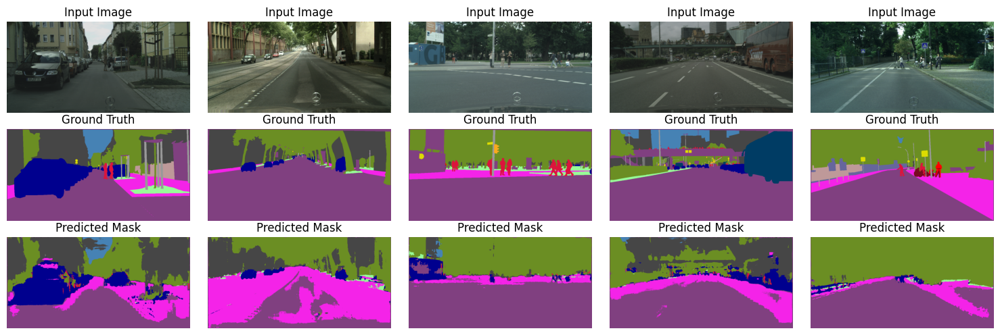

Epoch 2/60:


100%|██████████| 268/268 [05:59<00:00,  1.34s/it]

Training Loss: 2.1664, Dice Loss: 0.7355, Training Accuracy: 79.81%


Validation Loss: 1.9808, Dice Loss: 0.6563, Validation Accuracy: 80.80%


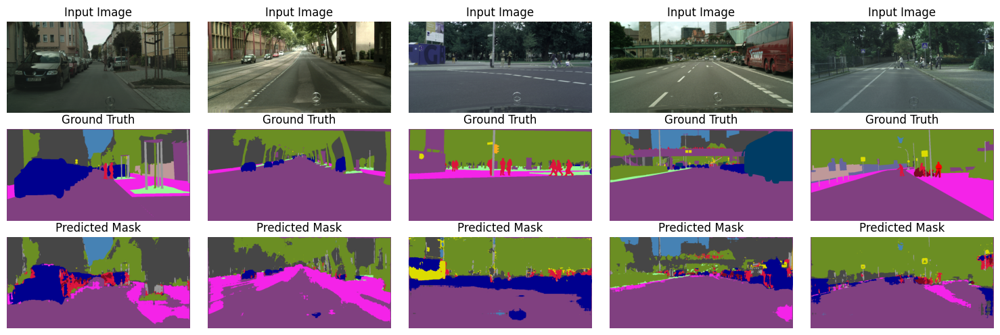

Epoch 3/60:


100%|██████████| 268/268 [05:59<00:00,  1.34s/it]

Training Loss: 1.8676, Dice Loss: 0.6338, Training Accuracy: 82.69%


Validation Loss: 1.8123, Dice Loss: 0.6137, Validation Accuracy: 83.59%


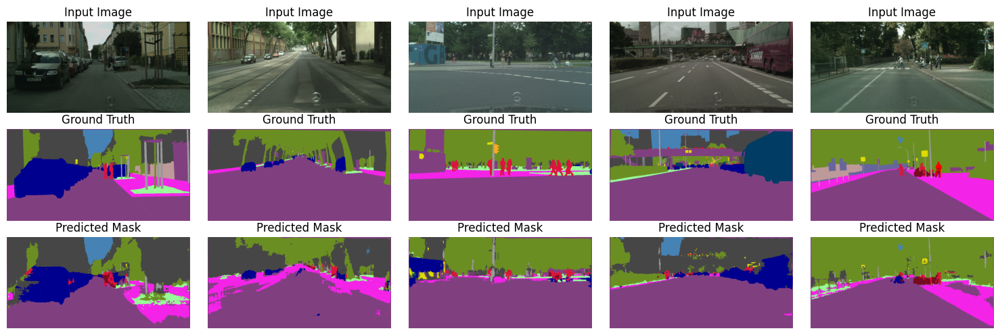

Epoch 4/60:


100%|██████████| 268/268 [05:59<00:00,  1.34s/it]

Training Loss: 1.7263, Dice Loss: 0.5939, Training Accuracy: 84.48%


Validation Loss: 1.7754, Dice Loss: 0.5954, Validation Accuracy: 83.62%


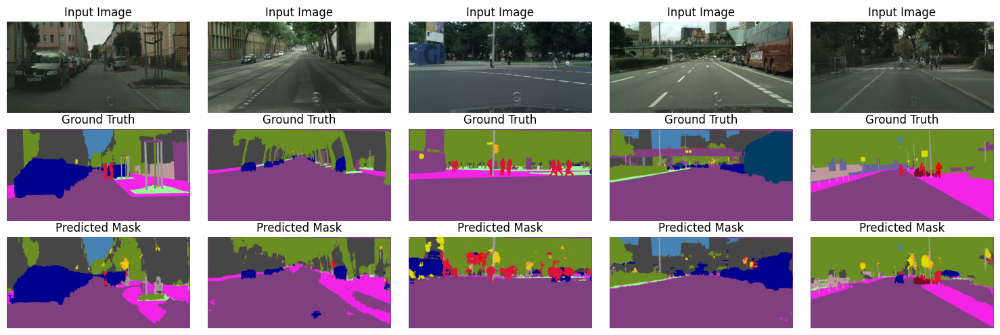

Epoch 5/60:


100%|██████████| 268/268 [06:00<00:00,  1.34s/it]

Training Loss: 1.6161, Dice Loss: 0.5576, Training Accuracy: 85.64%


Validation Loss: 1.6722, Dice Loss: 0.5558, Validation Accuracy: 83.62%


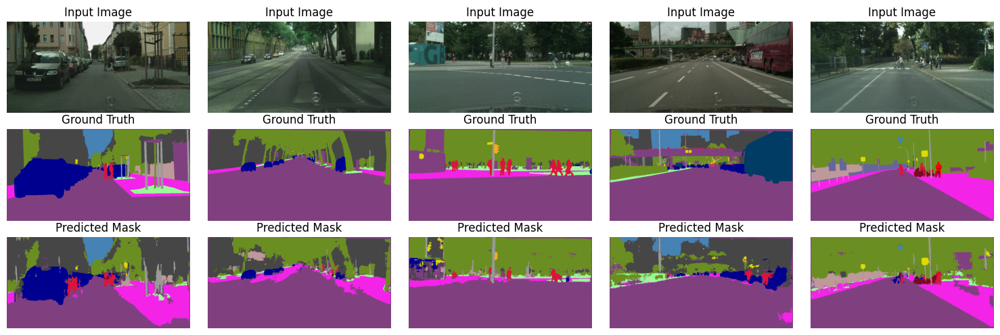

Epoch 6/60:


100%|██████████| 268/268 [06:00<00:00,  1.34s/it]

Training Loss: 1.5133, Dice Loss: 0.5242, Training Accuracy: 86.66%


Validation Loss: 1.5235, Dice Loss: 0.5217, Validation Accuracy: 86.08%


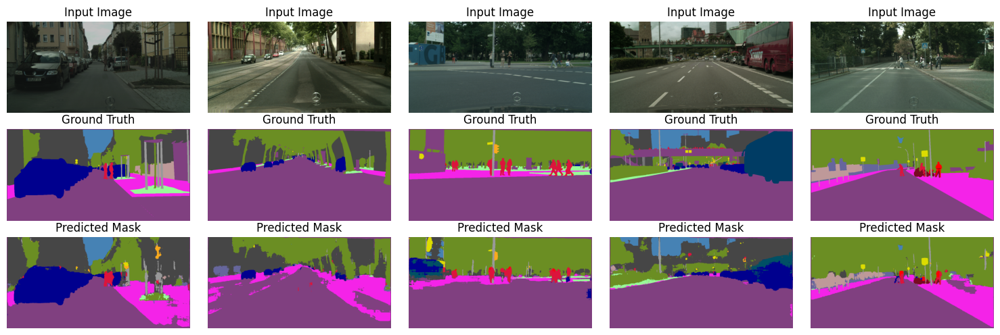

Epoch 7/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 1.4247, Dice Loss: 0.4935, Training Accuracy: 87.49%


Validation Loss: 1.4568, Dice Loss: 0.5002, Validation Accuracy: 86.71%


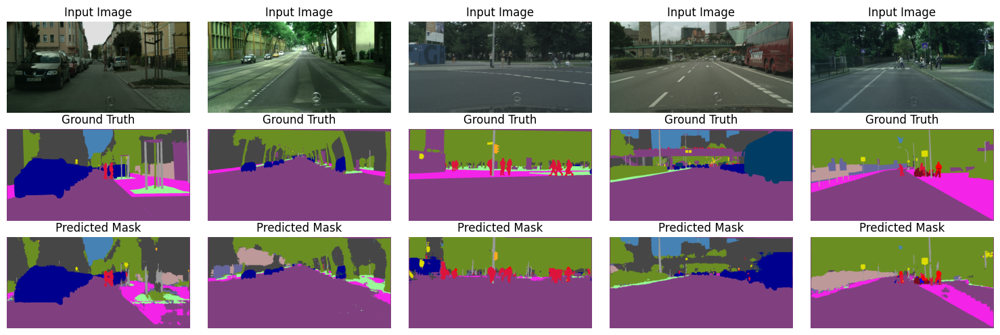

Epoch 8/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 1.3651, Dice Loss: 0.4733, Training Accuracy: 87.98%


Validation Loss: 1.3643, Dice Loss: 0.4716, Validation Accuracy: 87.94%


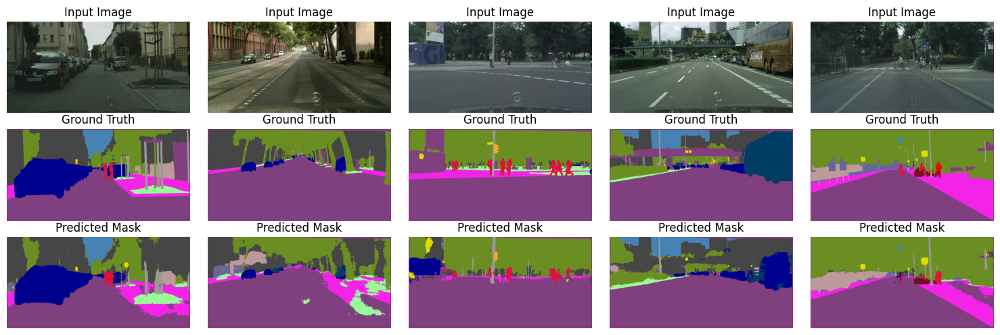

Epoch 9/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 1.3082, Dice Loss: 0.4525, Training Accuracy: 88.47%


Validation Loss: 1.4066, Dice Loss: 0.4702, Validation Accuracy: 87.10%


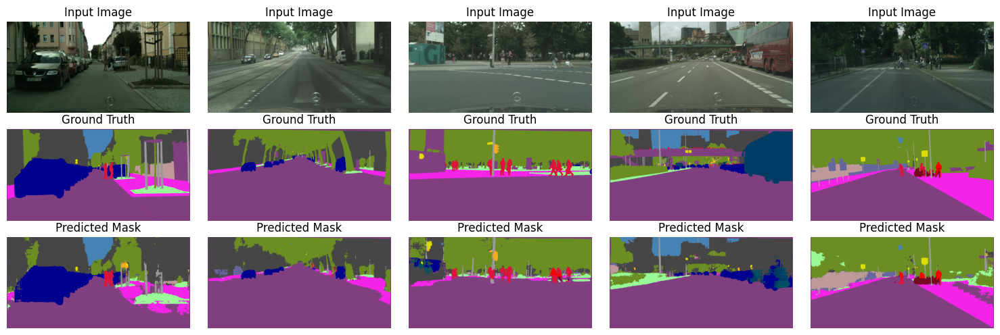

Epoch 10/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 1.2642, Dice Loss: 0.4371, Training Accuracy: 88.82%


Validation Loss: 1.3623, Dice Loss: 0.4613, Validation Accuracy: 87.29%


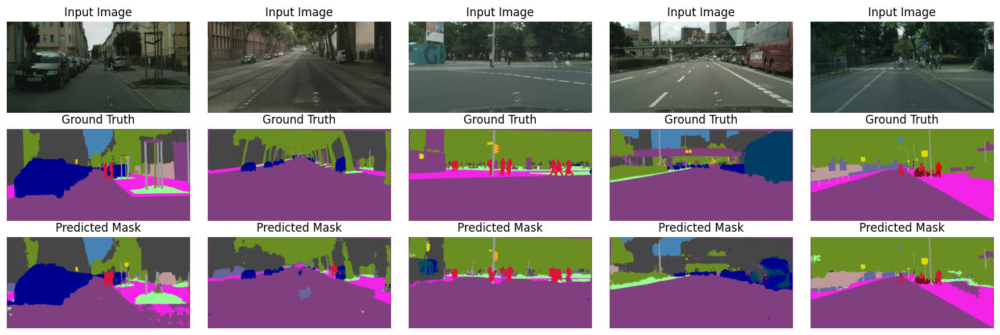

Epoch 11/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 1.2298, Dice Loss: 0.4258, Training Accuracy: 89.13%


Validation Loss: 1.3362, Dice Loss: 0.4529, Validation Accuracy: 88.01%


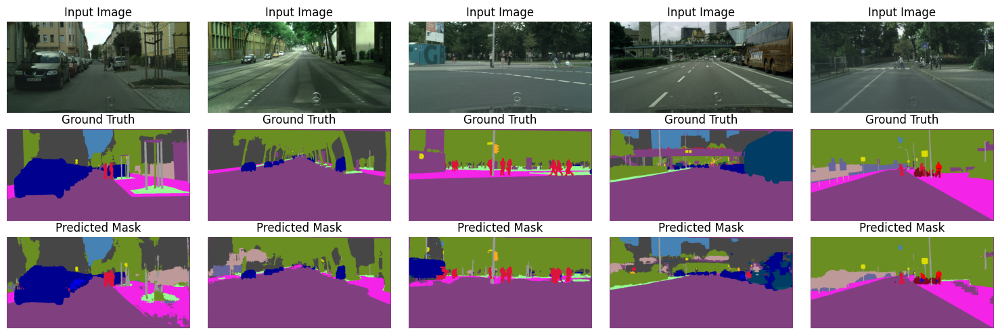

Epoch 12/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 1.1802, Dice Loss: 0.4098, Training Accuracy: 89.67%


Validation Loss: 1.3386, Dice Loss: 0.4485, Validation Accuracy: 87.13%


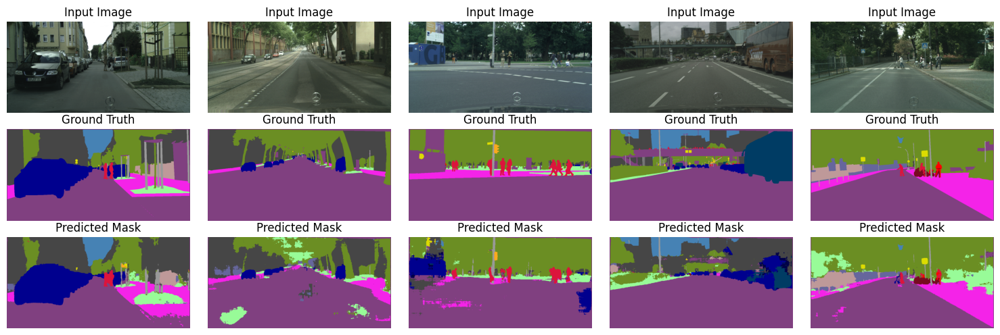

Epoch 13/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 1.1436, Dice Loss: 0.3963, Training Accuracy: 89.94%


Validation Loss: 1.2771, Dice Loss: 0.4352, Validation Accuracy: 88.49%


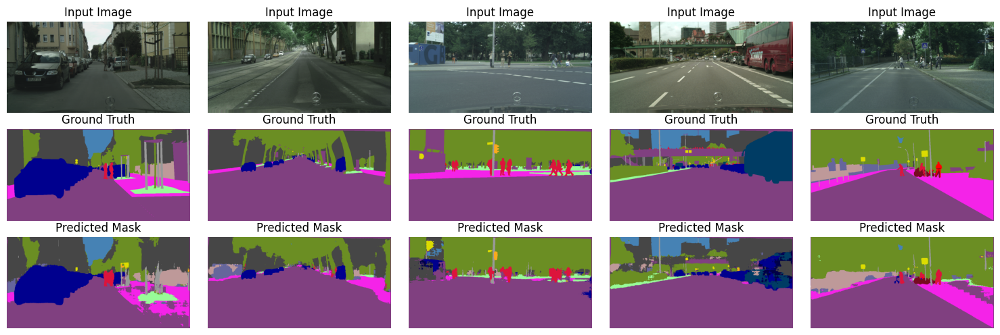

Epoch 14/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 1.1237, Dice Loss: 0.3891, Training Accuracy: 90.12%


Validation Loss: 1.2571, Dice Loss: 0.4309, Validation Accuracy: 88.48%


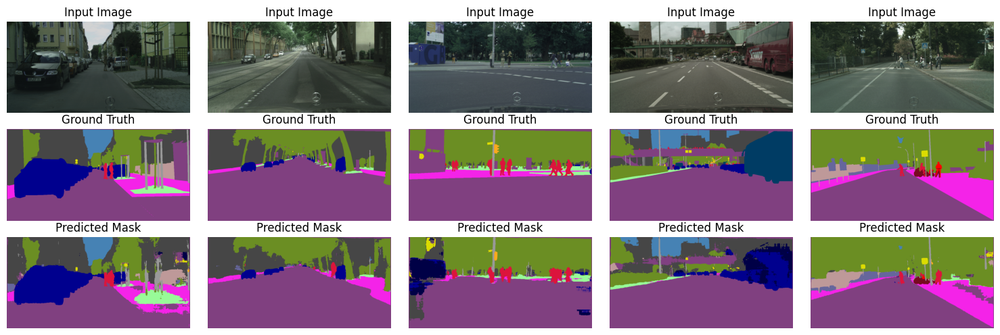

Epoch 15/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 1.0920, Dice Loss: 0.3780, Training Accuracy: 90.40%


Validation Loss: 1.2312, Dice Loss: 0.4203, Validation Accuracy: 89.43%


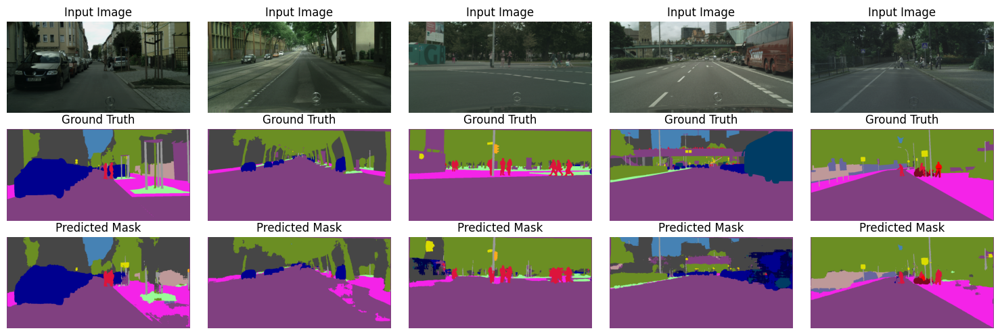

Epoch 16/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 1.1029, Dice Loss: 0.3812, Training Accuracy: 90.34%


Validation Loss: 1.3195, Dice Loss: 0.4367, Validation Accuracy: 87.63%


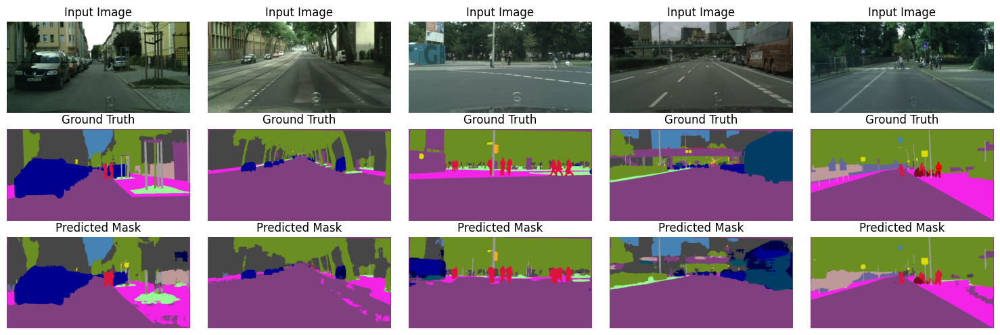

Epoch 17/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 1.0669, Dice Loss: 0.3681, Training Accuracy: 90.66%


Validation Loss: 1.2717, Dice Loss: 0.4194, Validation Accuracy: 88.44%


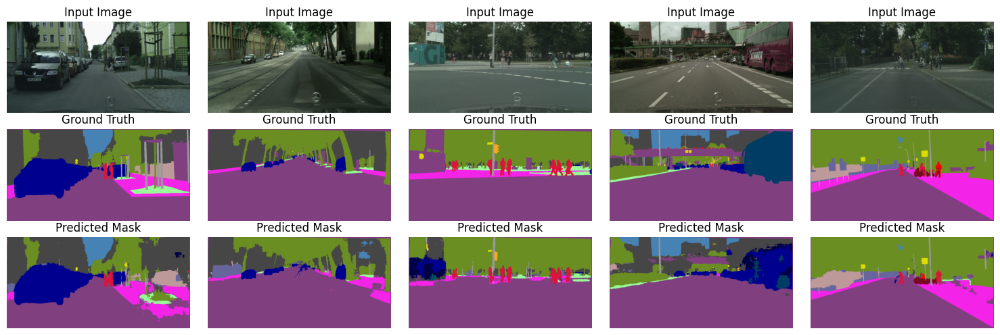

Epoch 18/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 1.0337, Dice Loss: 0.3572, Training Accuracy: 90.93%


Validation Loss: 1.2799, Dice Loss: 0.4272, Validation Accuracy: 88.47%


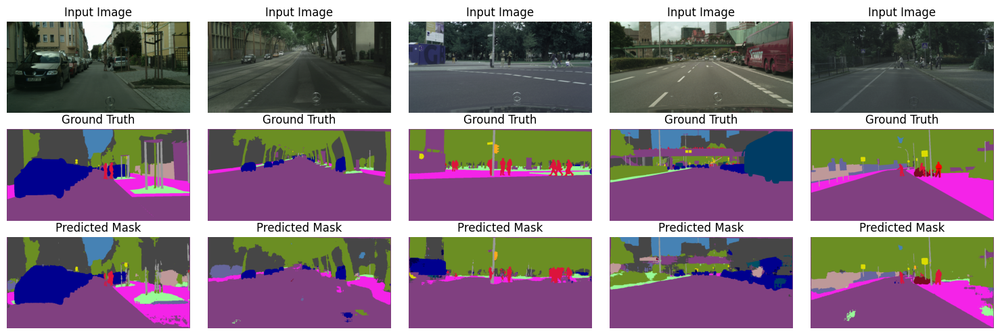

Epoch 19/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 1.0386, Dice Loss: 0.3582, Training Accuracy: 90.88%


Validation Loss: 1.1874, Dice Loss: 0.4013, Validation Accuracy: 89.67%


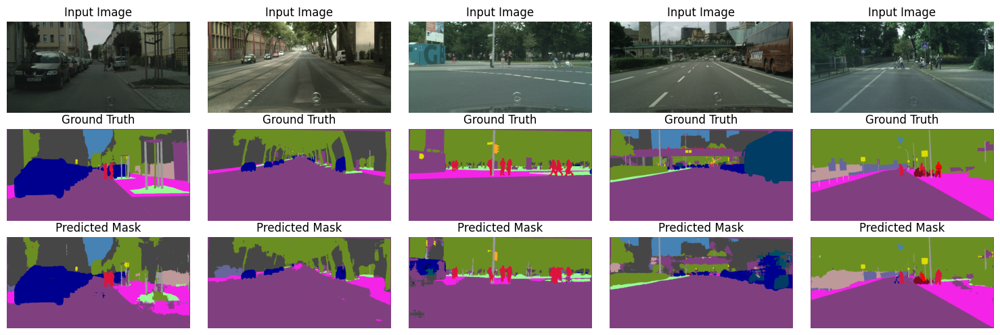

Epoch 20/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 1.0243, Dice Loss: 0.3546, Training Accuracy: 91.20%


Validation Loss: 1.1835, Dice Loss: 0.3980, Validation Accuracy: 89.64%


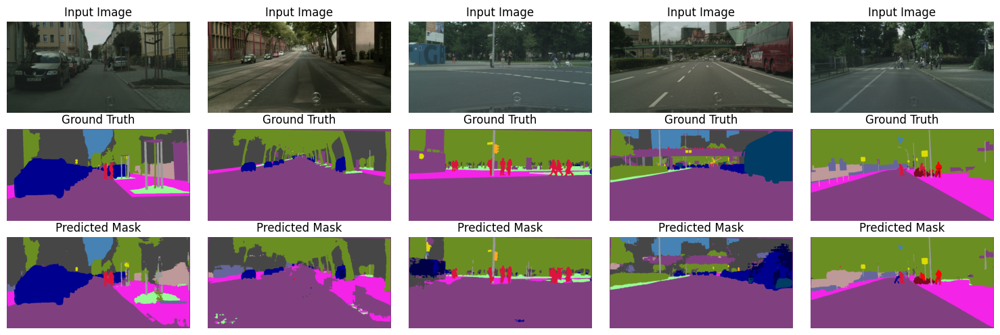

Epoch 21/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.9888, Dice Loss: 0.3415, Training Accuracy: 91.37%


Validation Loss: 1.2121, Dice Loss: 0.4063, Validation Accuracy: 89.07%


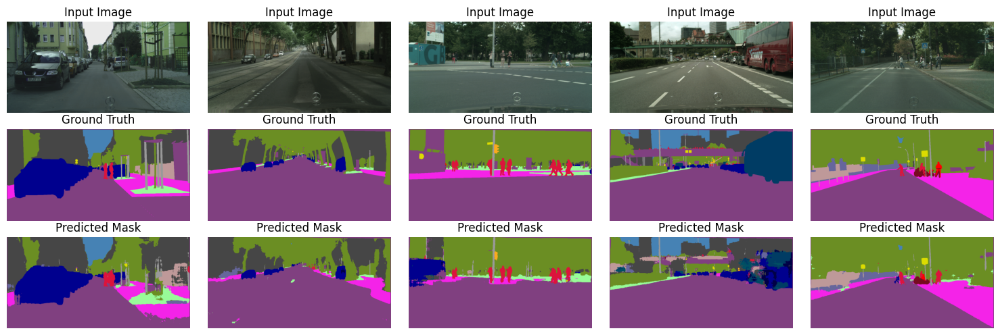

Epoch 22/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.9803, Dice Loss: 0.3398, Training Accuracy: 91.52%


Validation Loss: 1.1903, Dice Loss: 0.3951, Validation Accuracy: 89.74%


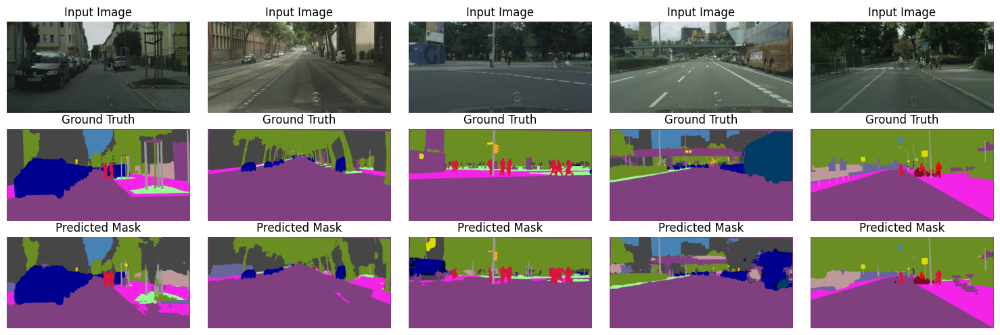

Epoch 23/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.9574, Dice Loss: 0.3322, Training Accuracy: 91.75%


Validation Loss: 1.2164, Dice Loss: 0.3996, Validation Accuracy: 89.19%


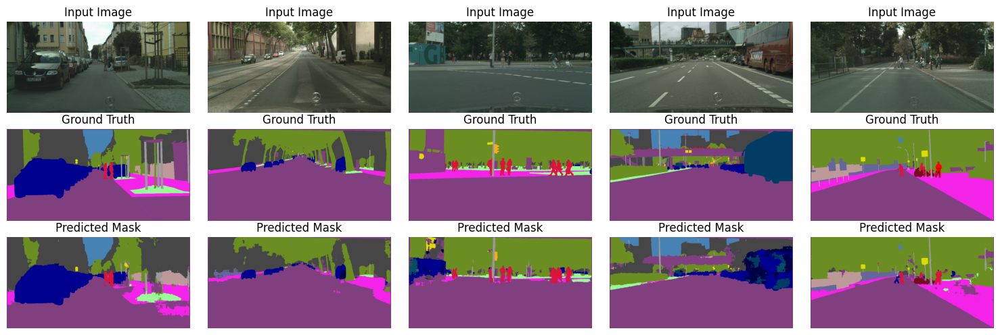

Epoch 24/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.9337, Dice Loss: 0.3248, Training Accuracy: 92.02%


Validation Loss: 1.2038, Dice Loss: 0.3947, Validation Accuracy: 89.51%


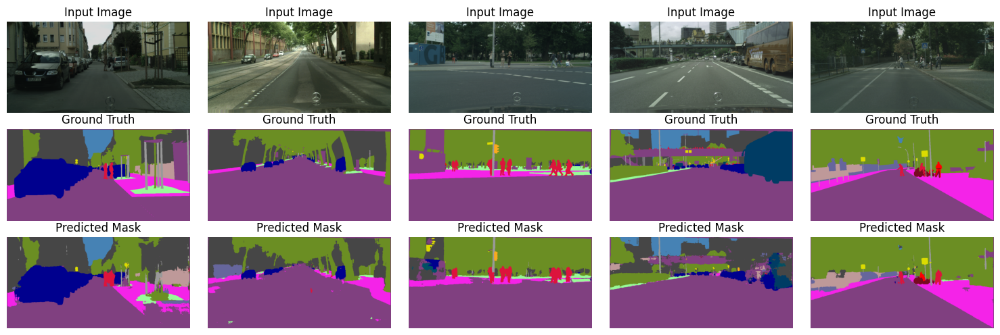

Epoch 25/60:


100%|██████████| 268/268 [06:00<00:00,  1.34s/it]

Training Loss: 0.9209, Dice Loss: 0.3197, Training Accuracy: 92.05%


Validation Loss: 1.1753, Dice Loss: 0.3939, Validation Accuracy: 89.77%


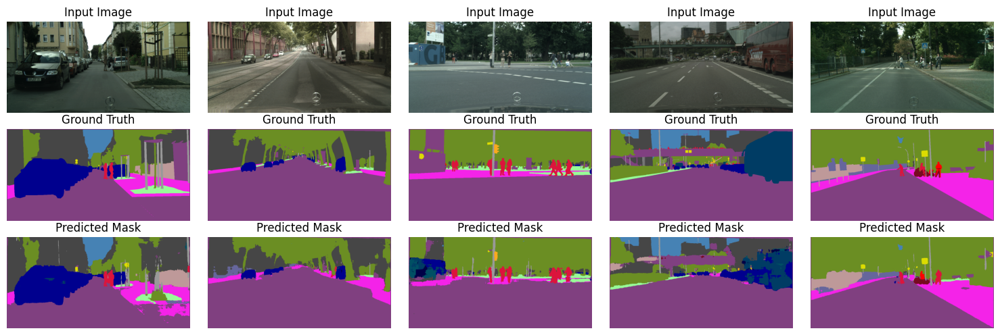

Epoch 26/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 0.9319, Dice Loss: 0.3209, Training Accuracy: 91.95%


Validation Loss: 1.1766, Dice Loss: 0.3920, Validation Accuracy: 89.78%


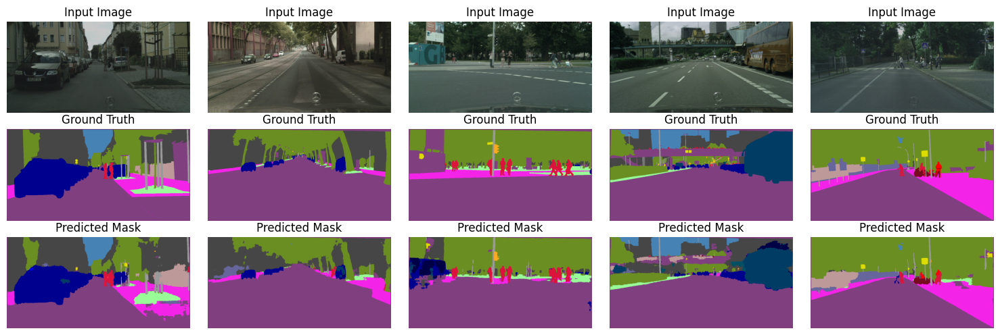

Epoch 27/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 0.9281, Dice Loss: 0.3129, Training Accuracy: 91.90%


Validation Loss: 1.1935, Dice Loss: 0.3845, Validation Accuracy: 89.89%


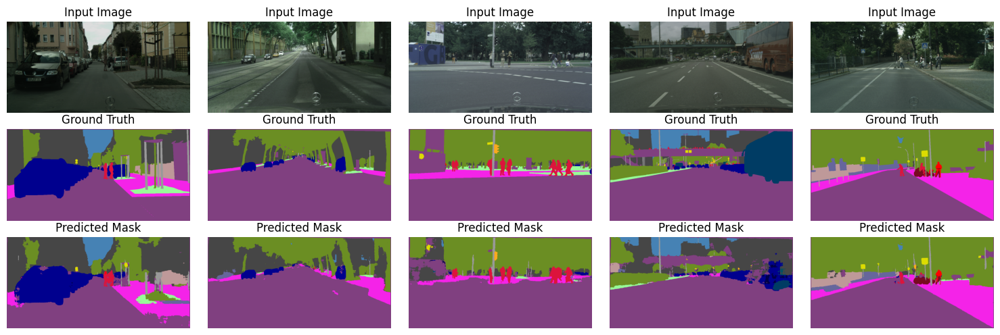

Epoch 28/60:


100%|██████████| 268/268 [06:00<00:00,  1.34s/it]

Training Loss: 0.8759, Dice Loss: 0.2949, Training Accuracy: 92.26%


Validation Loss: 1.2130, Dice Loss: 0.3847, Validation Accuracy: 89.74%


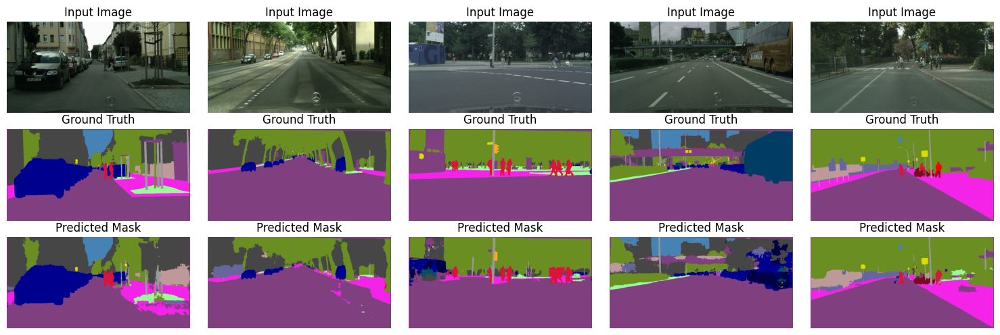

Epoch 29/60:


100%|██████████| 268/268 [06:00<00:00,  1.34s/it]

Training Loss: 0.9101, Dice Loss: 0.3066, Training Accuracy: 91.99%


Validation Loss: 1.2508, Dice Loss: 0.3909, Validation Accuracy: 89.37%


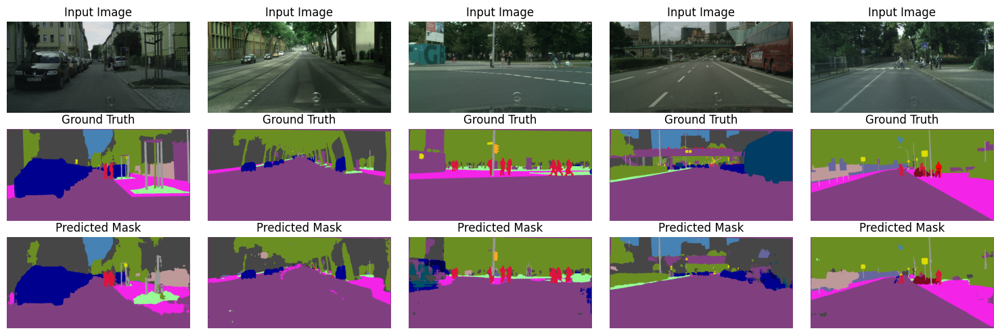

Epoch 30/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 0.8779, Dice Loss: 0.2929, Training Accuracy: 92.23%


Validation Loss: 1.2839, Dice Loss: 0.4048, Validation Accuracy: 89.21%


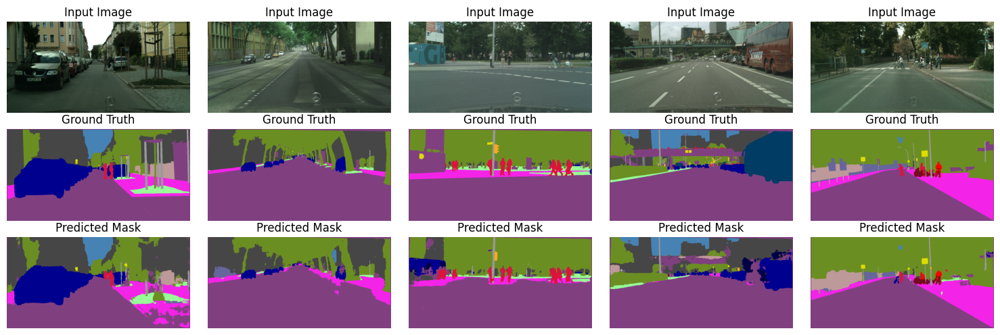

Epoch 31/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.8852, Dice Loss: 0.2953, Training Accuracy: 92.18%


Validation Loss: 1.2064, Dice Loss: 0.3876, Validation Accuracy: 89.83%


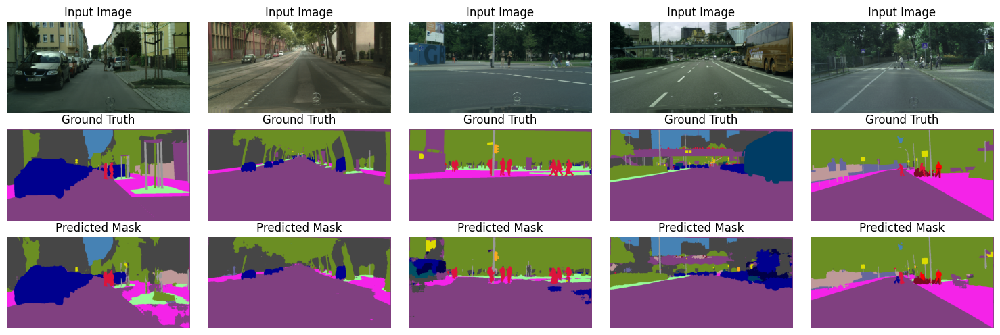

Epoch 32/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 0.8737, Dice Loss: 0.2941, Training Accuracy: 92.35%


Validation Loss: 1.1772, Dice Loss: 0.3757, Validation Accuracy: 89.98%


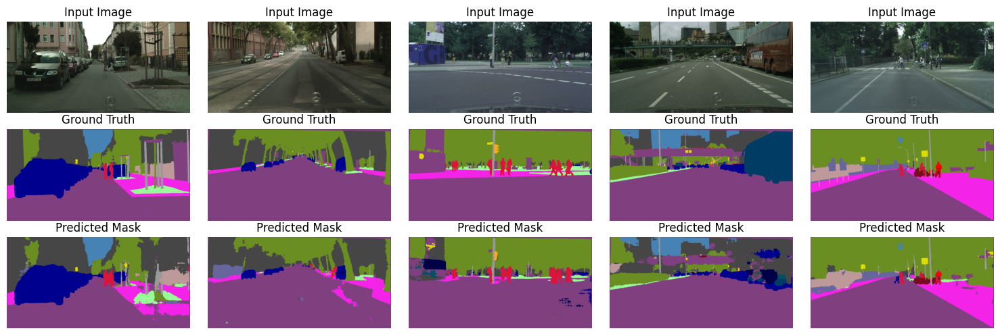

Epoch 33/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 0.8158, Dice Loss: 0.2728, Training Accuracy: 92.74%


Validation Loss: 1.1926, Dice Loss: 0.3772, Validation Accuracy: 89.93%


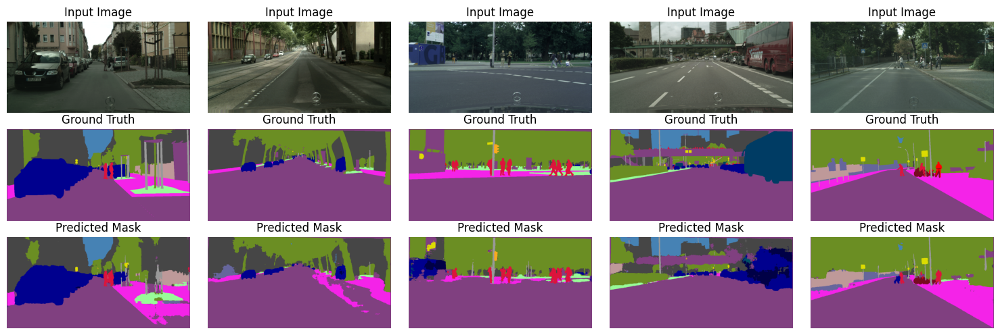

Epoch 34/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.8467, Dice Loss: 0.2771, Training Accuracy: 92.45%


Validation Loss: 1.2155, Dice Loss: 0.3753, Validation Accuracy: 89.79%


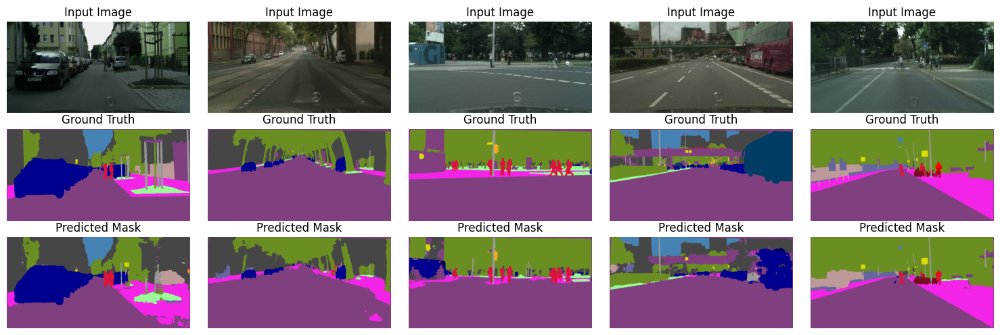

Epoch 35/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.8151, Dice Loss: 0.2550, Training Accuracy: 92.51%


Validation Loss: 1.2228, Dice Loss: 0.3698, Validation Accuracy: 89.32%


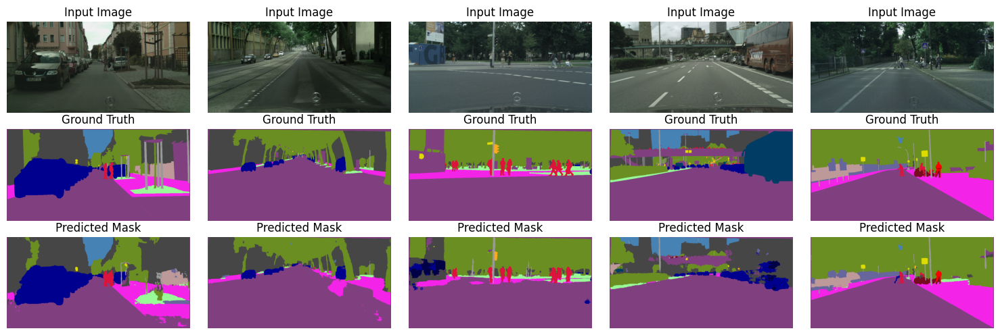

Epoch 36/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.8295, Dice Loss: 0.2626, Training Accuracy: 92.48%


Validation Loss: 1.2078, Dice Loss: 0.3636, Validation Accuracy: 89.01%


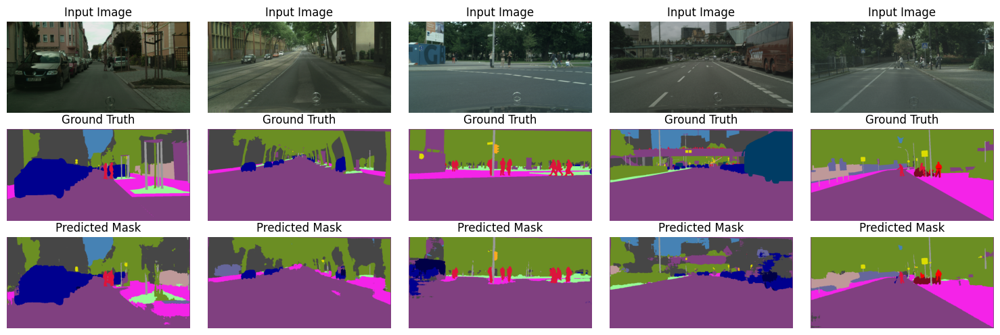

Epoch 37/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.8147, Dice Loss: 0.2602, Training Accuracy: 92.48%


Validation Loss: 1.2366, Dice Loss: 0.3659, Validation Accuracy: 89.07%


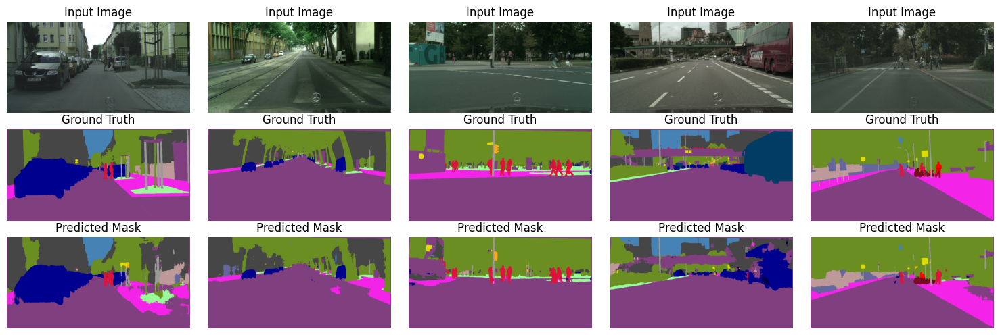

Epoch 38/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.7608, Dice Loss: 0.2460, Training Accuracy: 92.91%


Validation Loss: 1.1682, Dice Loss: 0.3546, Validation Accuracy: 89.88%


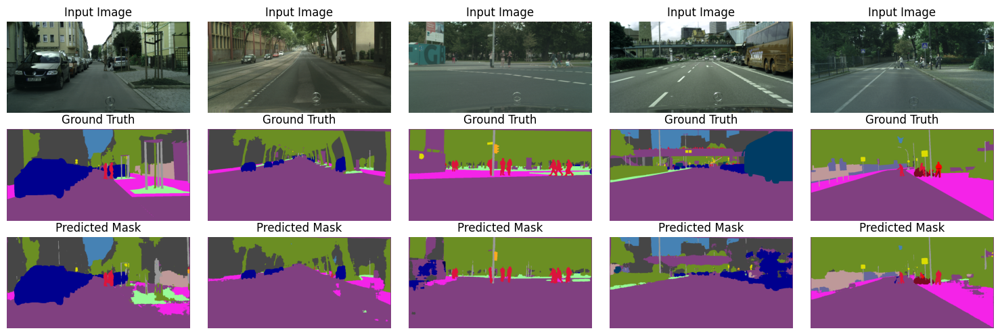

Epoch 39/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.7356, Dice Loss: 0.2359, Training Accuracy: 93.03%


Validation Loss: 1.2947, Dice Loss: 0.3755, Validation Accuracy: 88.92%


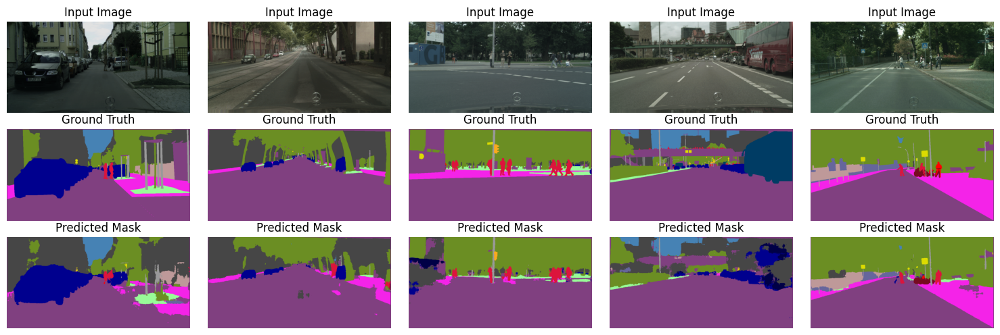

Epoch 40/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.7261, Dice Loss: 0.2353, Training Accuracy: 93.19%


Validation Loss: 1.2133, Dice Loss: 0.3534, Validation Accuracy: 89.90%


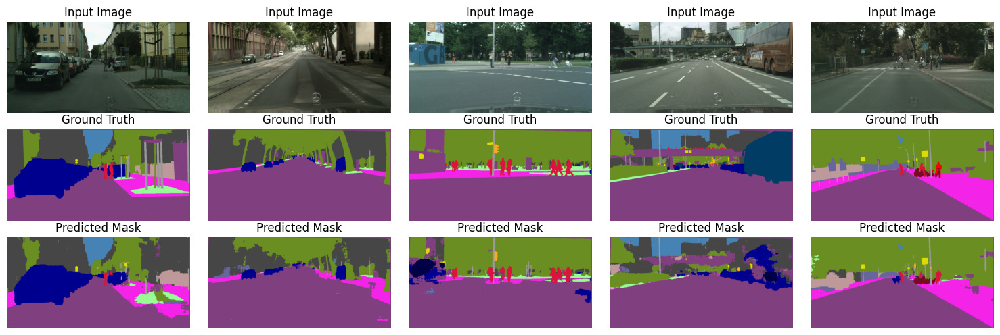

Epoch 41/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 0.6972, Dice Loss: 0.2212, Training Accuracy: 93.28%


Validation Loss: 1.2186, Dice Loss: 0.3892, Validation Accuracy: 89.72%


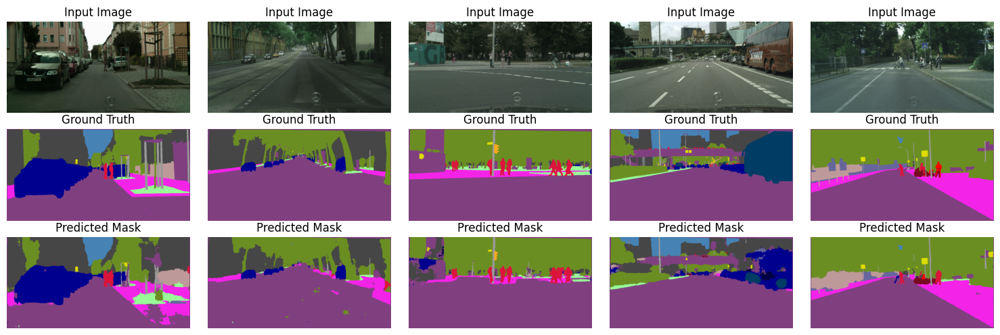

Epoch 42/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 0.7073, Dice Loss: 0.2243, Training Accuracy: 93.18%


Validation Loss: 1.2020, Dice Loss: 0.3774, Validation Accuracy: 89.66%


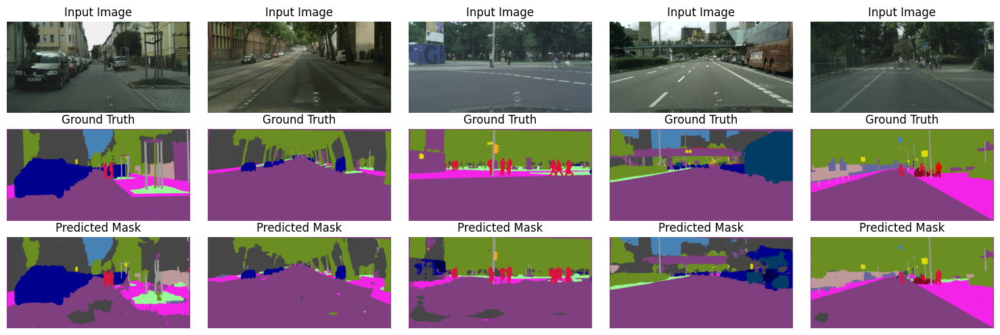

Epoch 43/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.7882, Dice Loss: 0.2456, Training Accuracy: 92.60%


Validation Loss: 1.2880, Dice Loss: 0.3657, Validation Accuracy: 89.44%


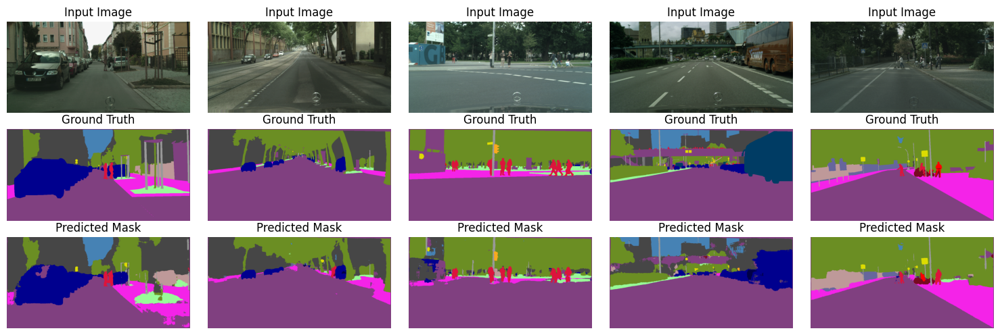

Epoch 44/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 0.7196, Dice Loss: 0.2275, Training Accuracy: 93.07%


Validation Loss: 1.2343, Dice Loss: 0.3787, Validation Accuracy: 89.73%


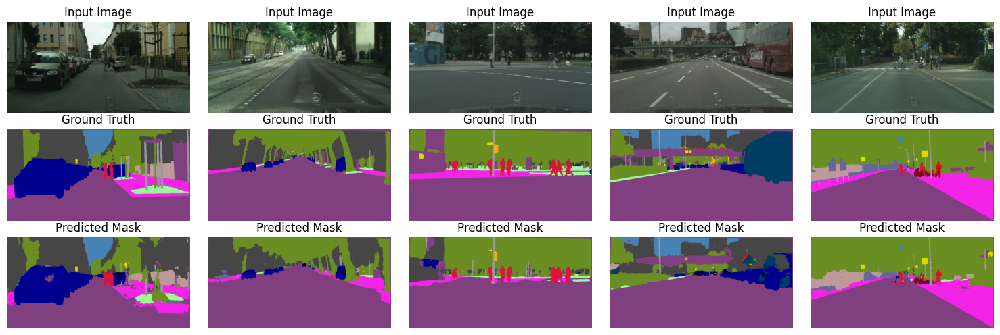

Epoch 45/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 0.7100, Dice Loss: 0.2264, Training Accuracy: 93.24%


Validation Loss: 1.1547, Dice Loss: 0.3563, Validation Accuracy: 90.30%


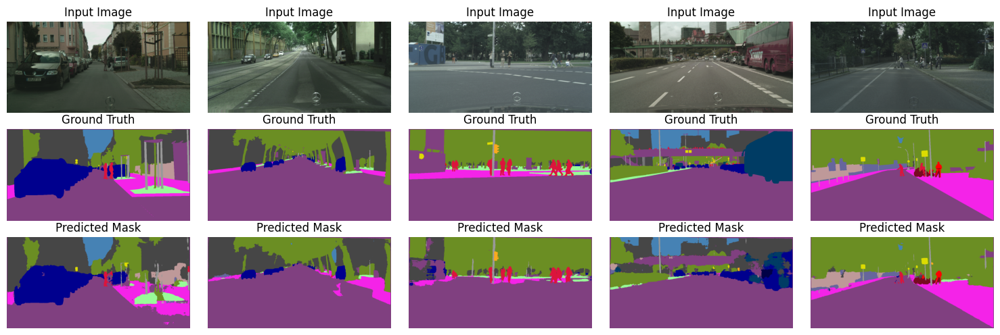

Epoch 46/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.6809, Dice Loss: 0.2136, Training Accuracy: 93.36%


Validation Loss: 1.2147, Dice Loss: 0.3657, Validation Accuracy: 89.83%


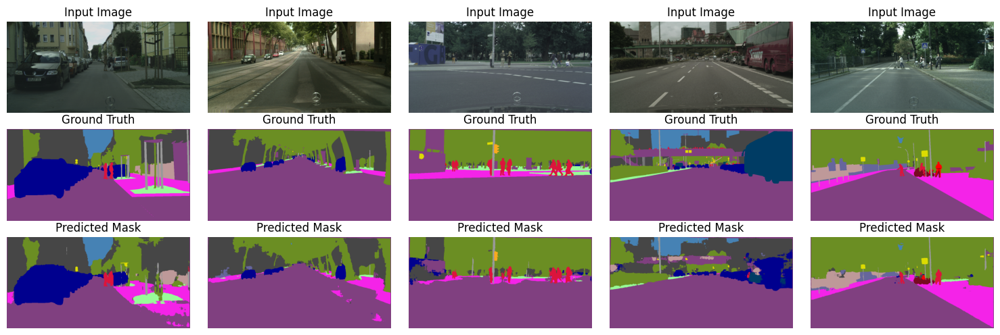

Epoch 47/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.6523, Dice Loss: 0.2041, Training Accuracy: 93.50%


Validation Loss: 1.2627, Dice Loss: 0.3579, Validation Accuracy: 89.69%


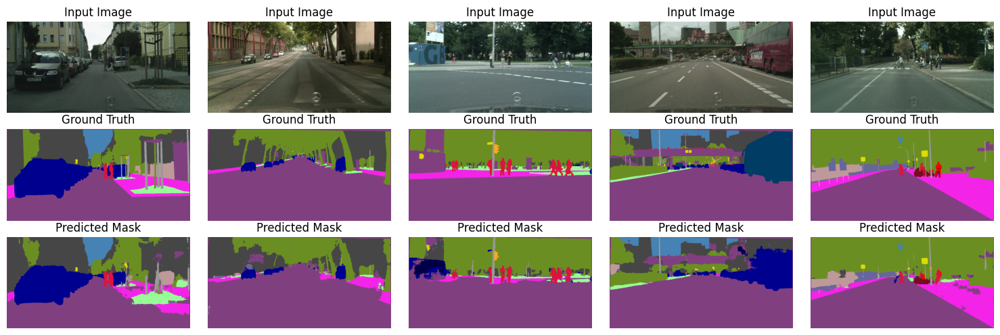

Epoch 48/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.6390, Dice Loss: 0.2008, Training Accuracy: 93.69%


Validation Loss: 1.2060, Dice Loss: 0.3583, Validation Accuracy: 89.68%


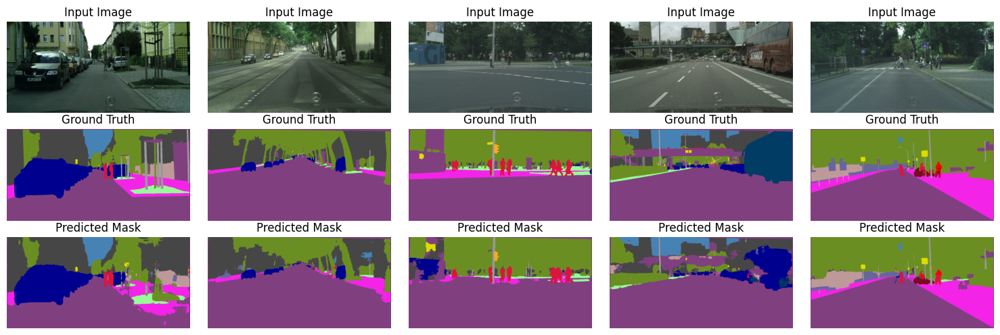

Epoch 49/60:


100%|██████████| 268/268 [06:00<00:00,  1.35s/it]

Training Loss: 0.6466, Dice Loss: 0.2020, Training Accuracy: 93.60%


Validation Loss: 1.1580, Dice Loss: 0.3539, Validation Accuracy: 90.24%


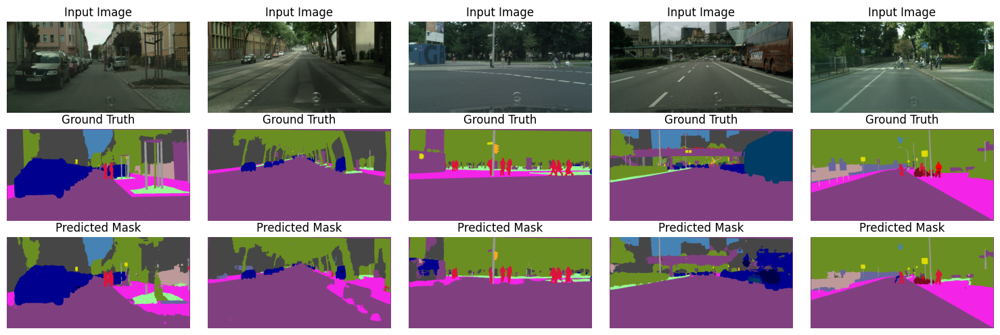

Epoch 50/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.6305, Dice Loss: 0.1978, Training Accuracy: 93.73%


Validation Loss: 1.2431, Dice Loss: 0.3639, Validation Accuracy: 89.91%


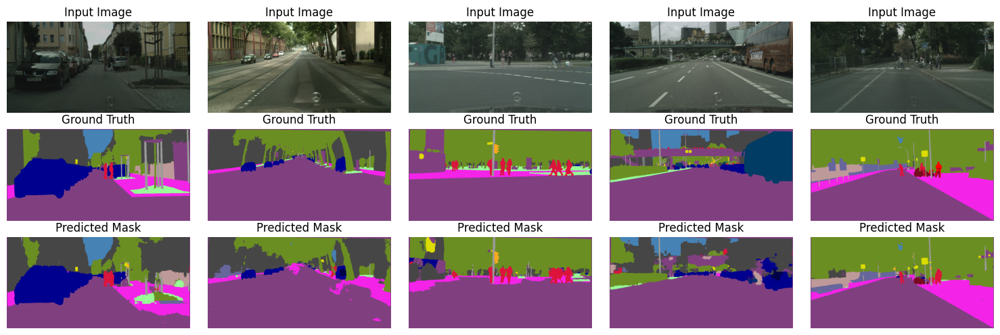

Epoch 51/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.7012, Dice Loss: 0.2191, Training Accuracy: 93.20%


Validation Loss: 1.3965, Dice Loss: 0.4337, Validation Accuracy: 88.21%


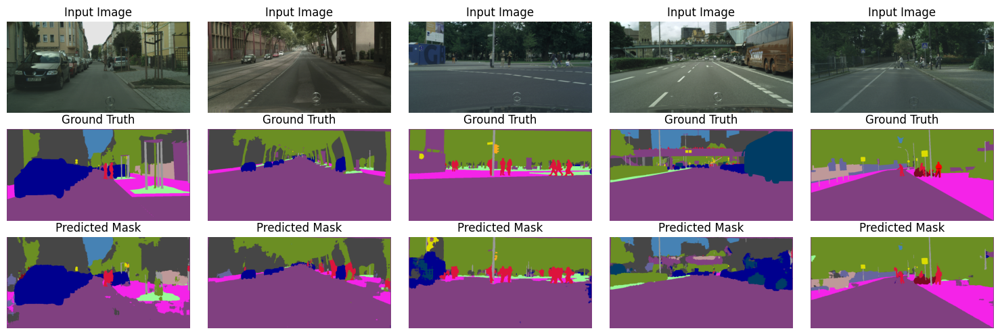

Epoch 52/60:


100%|██████████| 268/268 [06:00<00:00,  1.34s/it]

Training Loss: 0.6824, Dice Loss: 0.2135, Training Accuracy: 93.30%


Validation Loss: 1.2661, Dice Loss: 0.3593, Validation Accuracy: 89.50%


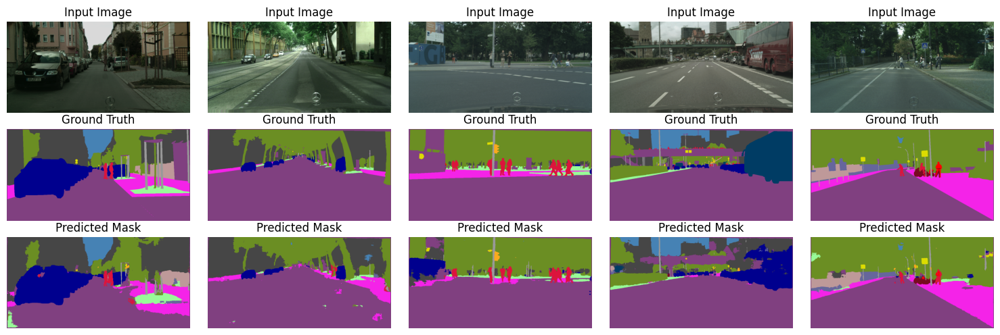

Epoch 53/60:


100%|██████████| 268/268 [06:02<00:00,  1.35s/it]

Training Loss: 0.6590, Dice Loss: 0.2061, Training Accuracy: 93.49%


Validation Loss: 1.2598, Dice Loss: 0.3417, Validation Accuracy: 90.03%


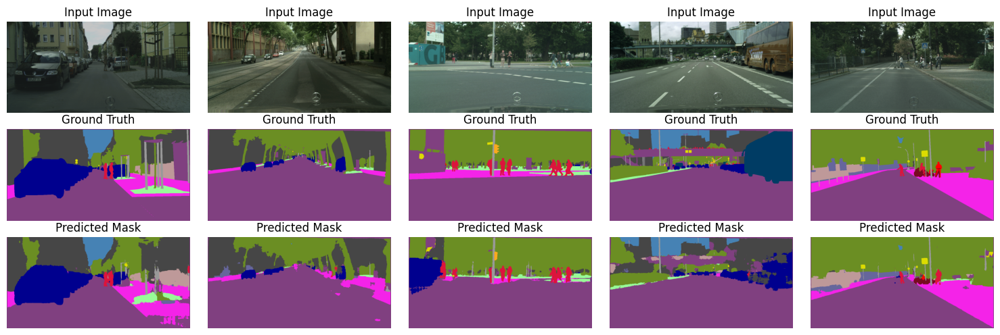

Epoch 54/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.6521, Dice Loss: 0.2049, Training Accuracy: 93.53%


Validation Loss: 1.2494, Dice Loss: 0.3441, Validation Accuracy: 90.14%


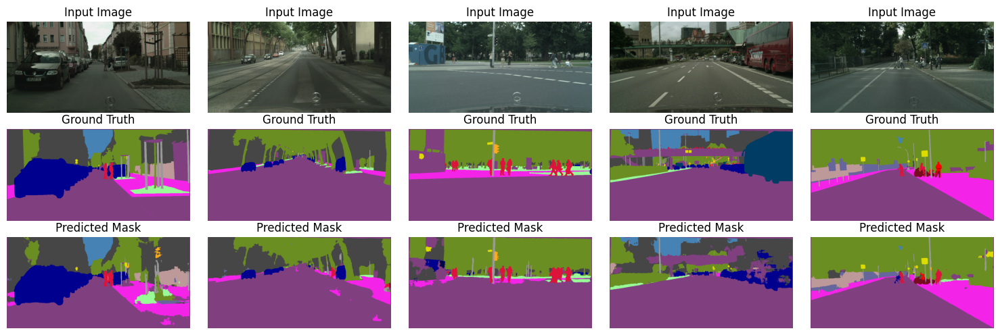

Epoch 55/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.6589, Dice Loss: 0.2074, Training Accuracy: 93.48%


Validation Loss: 1.3148, Dice Loss: 0.3934, Validation Accuracy: 88.99%


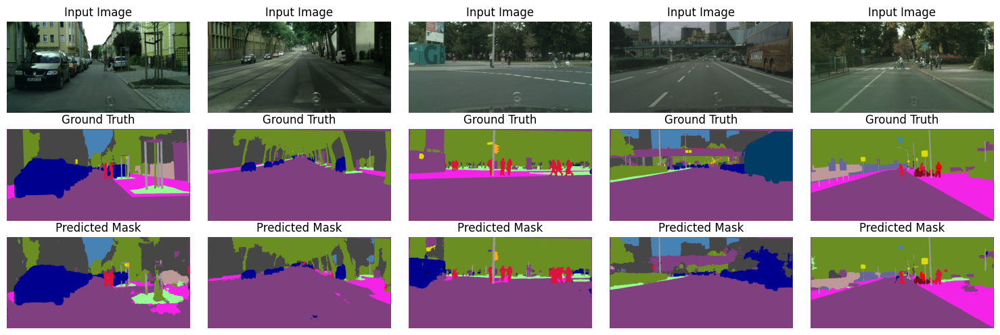

Epoch 56/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.6667, Dice Loss: 0.2107, Training Accuracy: 93.53%


Validation Loss: 1.1898, Dice Loss: 0.3720, Validation Accuracy: 90.05%


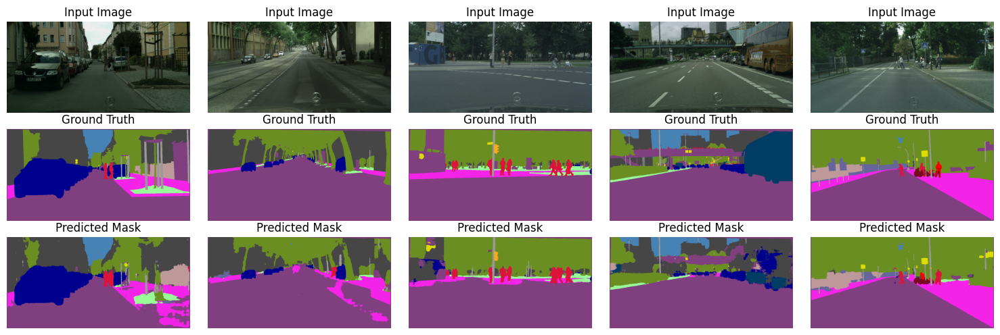

Epoch 57/60:


100%|██████████| 268/268 [06:02<00:00,  1.35s/it]

Training Loss: 0.6668, Dice Loss: 0.2104, Training Accuracy: 93.48%


Validation Loss: 1.2407, Dice Loss: 0.3645, Validation Accuracy: 89.69%


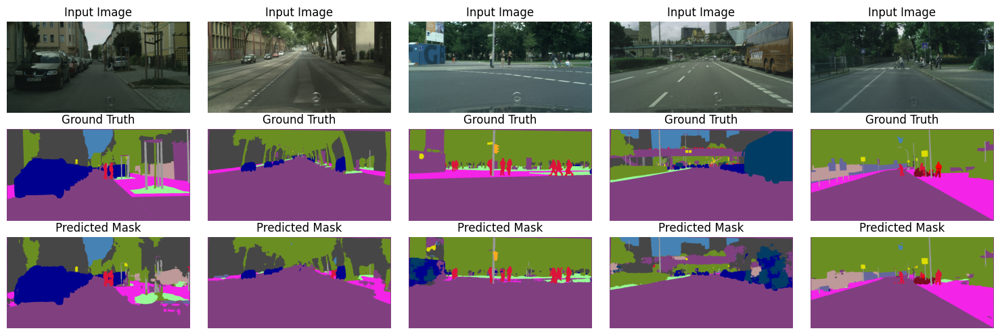

Epoch 58/60:


100%|██████████| 268/268 [06:02<00:00,  1.35s/it]

Training Loss: 0.6155, Dice Loss: 0.1970, Training Accuracy: 93.97%


Validation Loss: 1.2013, Dice Loss: 0.3522, Validation Accuracy: 90.05%


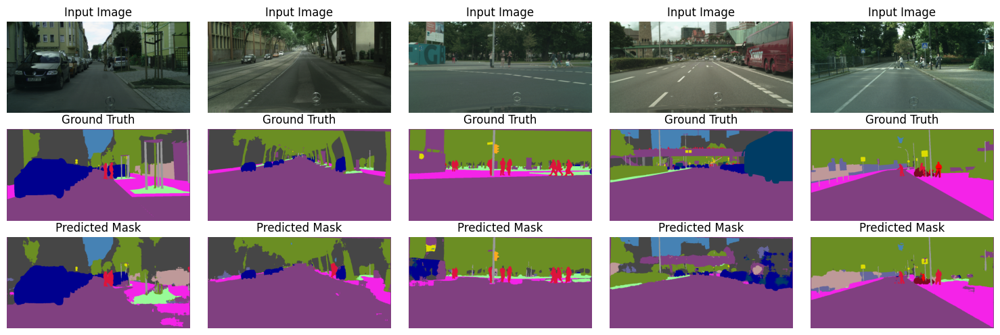

Epoch 59/60:


100%|██████████| 268/268 [06:01<00:00,  1.35s/it]

Training Loss: 0.5992, Dice Loss: 0.1914, Training Accuracy: 94.17%


Validation Loss: 1.1467, Dice Loss: 0.3685, Validation Accuracy: 90.63%


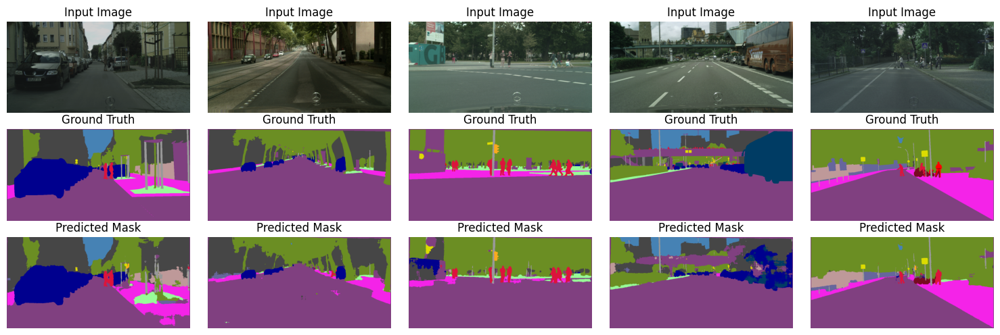

Epoch 60/60:


100%|██████████| 268/268 [06:02<00:00,  1.35s/it]

Training Loss: 0.5971, Dice Loss: 0.1880, Training Accuracy: 94.05%


Validation Loss: 1.3168, Dice Loss: 0.3652, Validation Accuracy: 88.66%


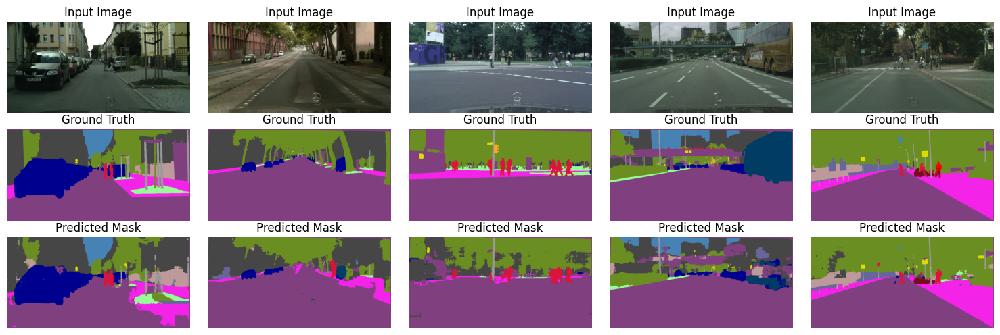

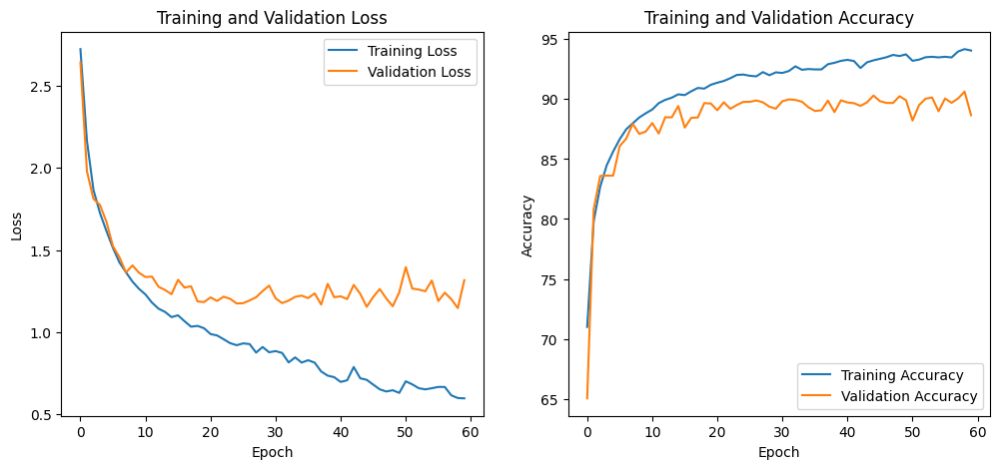

In [19]:
import torch
import torch.optim as optim
import torch.nn.functional as F
from tqdm import tqdm

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Move model to device
model = model.to(device)

# Wrap the model in DataParallel to utilize multiple GPUs
if torch.cuda.device_count() > 1:
    model = torch.nn.DataParallel(model)

# Training function
def train(model, train_dataloader, optimizer, criterion, device):
    model.train()
    running_loss = 0.0
    running_dice_loss = 0.0
    correct = 0  # Correct predictions counter
    total = 0  # Total predictions counter

    for data, target in tqdm(train_dataloader):
        data, target = data.to(device), target.to(device)

        # Zero the gradients
        optimizer.zero_grad()

        # Forward pass
        output = model(data)  # Only main output is used

        # Compute the loss
        target = torch.argmax(target, dim=1)  # Convert to shape (batch_size, height, width)
        loss_main = criterion(output, target)
        dice = dice_loss(output, target)

        # Combine main loss and Dice loss
        loss = loss_main + 2 * dice  # Weighted combination

        # Backward pass and optimize
        loss.backward()
        optimizer.step()

        # Accumulate loss and Dice loss
        running_loss += loss.item()
        running_dice_loss += dice.item()

        # Calculate accuracy
        pred = output.argmax(dim=1, keepdim=True)  # Get the predicted classes
        correct += pred.eq(target.view_as(pred)).sum().item()  # Count correct predictions
        total += target.numel()  # Count total predictions (pixels)

    # Calculate average loss and accuracy
    avg_loss = running_loss / len(train_dataloader)
    avg_dice_loss = running_dice_loss / len(train_dataloader)
    accuracy = 100. * correct / total

    return avg_loss, avg_dice_loss, accuracy

# Validation function
def validate(model, val_dataloader, criterion, device):
    model.eval()
    val_loss = 0.0
    val_dice_loss = 0.0
    correct = 0
    total = 0

    with torch.no_grad():
        for data, target in val_dataloader:
            data, target = data.to(device), target.to(device)

            # Forward pass
            output = model(data)  # Only main output is used

            # Compute loss
            target = torch.argmax(target, dim=1)  # Convert to shape (batch_size, height, width)
            loss_main = criterion(output, target)
            dice = dice_loss(output, target)

            # Combine main loss and Dice loss
            loss = loss_main + 2* dice  # Weighted combination

            # Accumulate loss and Dice loss
            val_loss += loss.item()
            val_dice_loss += dice.item()

            # Calculate accuracy
            pred = output.argmax(dim=1, keepdim=True)  # Get the predicted classes
            correct += pred.eq(target.view_as(pred)).sum().item()  # Count correct predictions
            total += target.numel()  # Count total predictions (pixels)

    # Calculate average loss and accuracy
    avg_loss = val_loss / len(val_dataloader)
    avg_dice_loss = val_dice_loss / len(val_dataloader)
    accuracy = 100. * correct / total

    return avg_loss, avg_dice_loss, accuracy

# Training loop
n_epochs = 60
train_losses = []
val_losses = []
train_accuracies = []
val_accuracies = []

for epoch in range(1, n_epochs + 1):
    print(f"Epoch {epoch}/{n_epochs}:")

    # Training
    train_loss, train_dice_loss, train_accuracy = train(model, train_dataloader, optimizer, criterion, device)
    print(f"Training Loss: {train_loss:.4f}, Dice Loss: {train_dice_loss:.4f}, Training Accuracy: {train_accuracy:.2f}%")

    # Validation
    val_loss, val_dice_loss, val_accuracy = validate(model, val_dataloader, criterion, device)
    print(f"Validation Loss: {val_loss:.4f}, Dice Loss: {val_dice_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%")

    # Save losses and accuracies for plotting
    train_losses.append(train_loss)
    val_losses.append(val_loss)
    train_accuracies.append(train_accuracy)
    val_accuracies.append(val_accuracy)

    # Visualize the outputs after validation
    with torch.no_grad():
        for data, target in val_dataloader:
            data, target = data.to(device), target.to(device)
            output = model(data)
            visualize_output(data, target, output, num_images=5)  # Visualize 5 images
            break  # Remove this if you want to visualize from multiple batches

# Save the final model checkpoint
save_checkpoint(epoch, model, optimizer, train_loss, train_accuracy, checkpoint_path='checkpoint.pth')

# Plot training and validation losses
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()

# Plot training and validation accuracies
plt.subplot(1, 2, 2)
plt.plot(train_accuracies, label='Training Accuracy')
plt.plot(val_accuracies, label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend()

plt.show()